# Test the hologram performances with HD111980 data 30 may 2017
==================================================================================================

- author : Sylvie
- date   : October 2nd th 2017
- update : October 4th 2017





#### problem because limitation in output of data

- firt I tried to generate a config file for jupyter

If you ran jupyter notebook --generate-config to create it, it should be in the correct place already. If not, try putting it at ~/.jupyter/jupyter_notebook_config.py

- and I set : 
> c.NotebookApp.iopub_data_rate_limit = 1000000

but it failed again so I launch jupyter as follow:

> jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000 full_baseanalysis.ipynb 

So it behaves better

In [1]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [26]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Ana2DShapeSpectra
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/CTIOAnaJun2017/ana_30may17/HD111980


In [3]:
from astropy.modeling import models, fitting

In [4]:
import pandas as pd

# Input directory

In [5]:
#inputdir="../OverScanRemove/trim_images"
#inputdir="../../data/CTIODataJune2017_reducedRed/data_05jun17/"
inputdir="./rotated_fitsimages"
MIN_IMGNUMBER=58
MAX_IMGNUMBER=190
date="20170530"
object_name='HD111980'
tag = "rotimg"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

# Output directory

In [6]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./spectrum_fitsspec"
ensure_dir(outputdir)

# Open files
===================================

## order 0 postion

In [7]:
df=pd.read_csv('xy_pointing.csv')
x_star=df["x_pointing"]
y_star=df["y_pointing"]
all_theta=df["theta"]
x_pointing=x_star
y_pointing=y_star

In [8]:
order0_positions = np.array([x_pointing,y_pointing]).T

## Input image files

- rotated and cut images

In [9]:
sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 
all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 133


In [10]:
print all_filt

['dia Thor300', 'dia Thor300', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg

## Check calib info on holograms and disperser

In [11]:
all_grat = []
all_holo = []
for f in all_filt :
    #all_grat.append(f.replace('RG715 ',''))
    all_grat.append(f.replace('dia ',''))
for index,g in enumerate(all_grat):
    holo = Hologram(g,verbose=False)
    #all_holo.append[holo]
    print 'holo_name=',g,'holo_theta=',holo.theta(order0_positions[index]),' rot_theta',all_theta[index],'order0_positions', order0_positions[index]

holo_name= Thor300 holo_theta= -0.575  rot_theta -0.631328217109 order0_positions [ 1030.04822153  1020.56040991]
holo_name= Thor300 holo_theta= -0.575  rot_theta -0.722092660425 order0_positions [ 778.0339466   701.43797984]
holo_name= Ron400 holo_theta= -0.277  rot_theta -0.618445201583 order0_positions [ 749.          702.06663822]
holo_name= Thor300 holo_theta= -0.575  rot_theta -0.720939264498 order0_positions [ 780.2606922   702.08821523]
holo_name= HoloPhP holo_theta= [-0.93742801]  rot_theta -0.96725638728 order0_positions [ 780.22463355  701.00414514]
holo_name= HoloPhAg holo_theta= [-1.48445194]  rot_theta -1.85657427625 order0_positions [ 749.          701.33402808]
holo_name= HoloAmAg holo_theta= [-1.5111581]  rot_theta -1.47321773733 order0_positions [ 748.         700.4620186]
holo_name= Ron400 holo_theta= -0.277  rot_theta -0.630236090877 order0_positions [ 778.67598582  700.79460194]
holo_name= Thor300 holo_theta= -0.575  rot_theta -0.728008954576 order0_positions [ 778

holo_name= HoloAmAg holo_theta= [-1.57260379]  rot_theta -1.52608735379 order0_positions [ 747.09563071  684.33432374]
holo_name= Ron400 holo_theta= -0.277  rot_theta -0.630312646978 order0_positions [ 747.74810625  684.08598583]
holo_name= Thor300 holo_theta= -0.575  rot_theta -0.815354268392 order0_positions [ 746.64932944  685.44841389]
holo_name= HoloPhP holo_theta= [-0.91430255]  rot_theta -0.952134333771 order0_positions [ 746.27008339  684.96533586]
holo_name= HoloPhAg holo_theta= [-1.53157424]  rot_theta -1.9339180628 order0_positions [ 746.11217134  682.63809855]
holo_name= HoloAmAg holo_theta= [-1.57504686]  rot_theta -1.57070652643 order0_positions [ 743.70063716  683.10713557]
holo_name= Ron400 holo_theta= -0.277  rot_theta -0.692973946757 order0_positions [ 742.11865333  682.73747504]
holo_name= Thor300 holo_theta= -0.575  rot_theta -0.868412923423 order0_positions [ 742.88630733  684.62957499]
holo_name= HoloPhP holo_theta= [-0.91431619]  rot_theta -0.969029796742 order0_

## Show filters and dispersers

In [16]:
Filt_names

['dia Ron400',
 'dia Thor300',
 'dia HoloPhP',
 'dia HoloPhAg',
 'dia HoloAmAg',
 'dia Ron200',
 'Unknown']

In [12]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

In [13]:
print Filt_names[0],filt0_idx
print Filt_names[1],filt1_idx
print Filt_names[2],filt2_idx
print Filt_names[3],filt3_idx
print Filt_names[4],filt4_idx
print Filt_names[5],filt5_idx
print Filt_names[6],filt6_idx

dia Ron400 [  2   7  12  17  22  27  32  37  42  47  52  57  62  67  72  77  82  87
  92  97 102 107 112 117 122 127 132]
dia Thor300 [  0   1   3   8  13  18  23  28  33  38  43  48  53  58  63  68  73  78
  83  88  93  98 103 108 113 118 123 128]
dia HoloPhP [  4   9  14  19  24  29  34  39  44  49  54  59  64  69  74  79  84  89
  94  99 104 109 114 119 124 129]
dia HoloPhAg [  5  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90
  95 100 105 110 115 120 125 130]
dia HoloAmAg [  6  11  16  21  26  31  36  41  46  51  56  61  66  71  76  81  86  91
  96 101 106 111 116 121 126 131]
dia Ron200 []
Unknown []


# Input images


Notice, we expect the spectrum is centered in vertical.
The central star is at the origin in the raw image

## Full rotated image

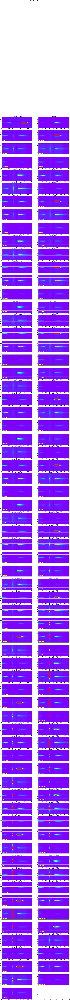

In [19]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)

## Center of central star

Obviously the previous estimation of the center is wrong

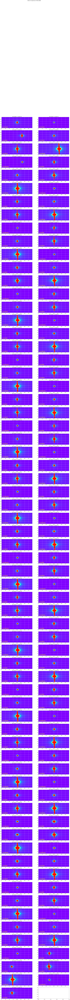

In [14]:
# Center : Order 0
# start at star
y_star0=[all_images[0].shape[0]/2]*len(all_images)
x_star0=x_star
#ShowCenterImages([1300]*len(all_images),y_star0,[500]*len(all_images),[25]*len(all_images),
#                all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)
ShowCenterImages(x_star0,y_star0,[100]*len(all_images),[50]*len(all_images),
                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)

title='Order 0 of spectrum of {} '.format(object_name)
plt.suptitle(title,size=16)
figfilename=os.path.join(dir_top_images,'order0.pdf')
plt.savefig(figfilename)  

### check weighted_avg_and_std is a good estimator of the central position

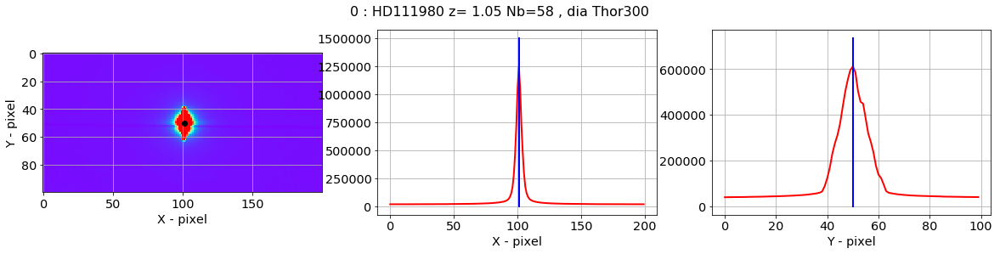

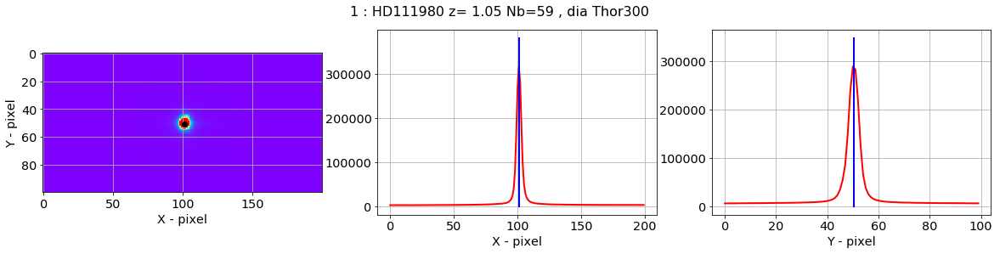

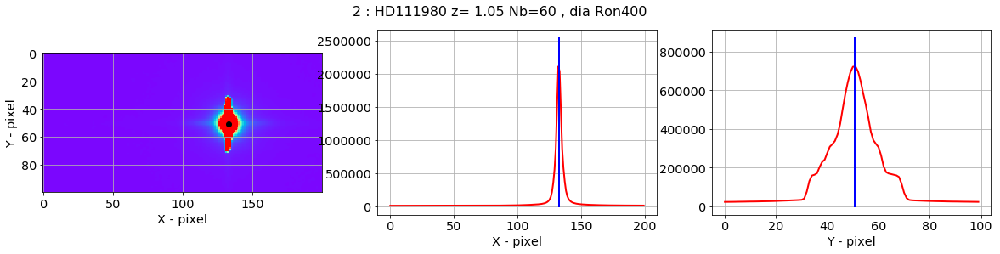

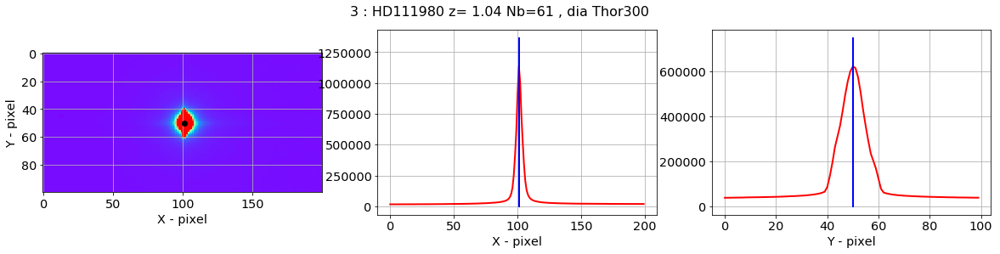

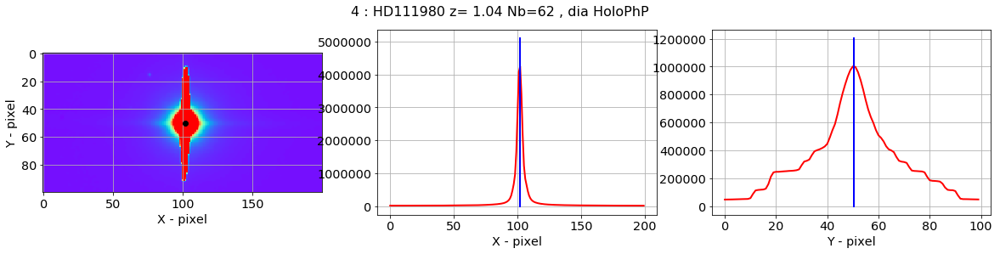

...

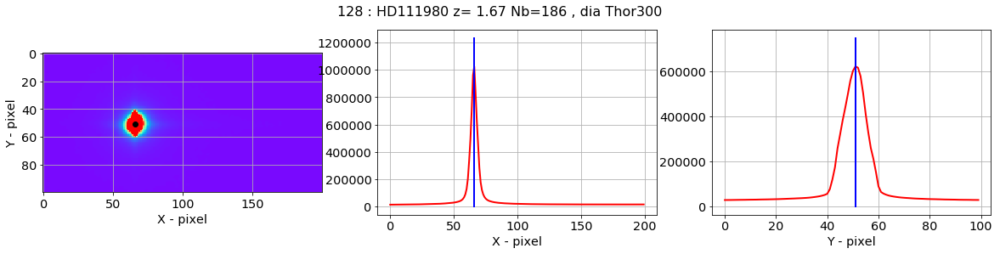

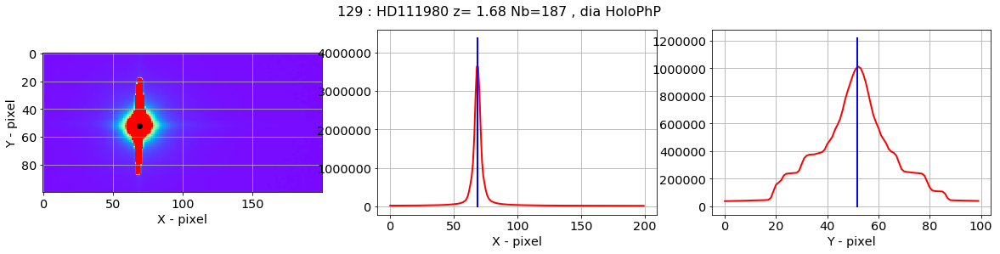

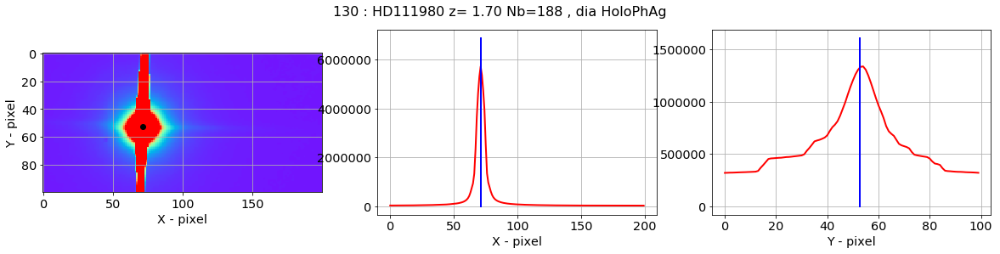

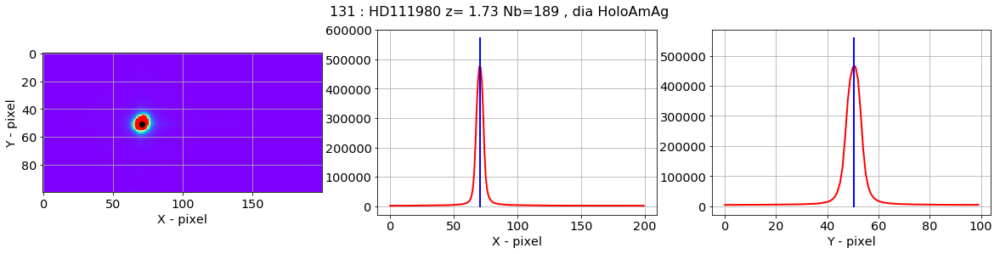

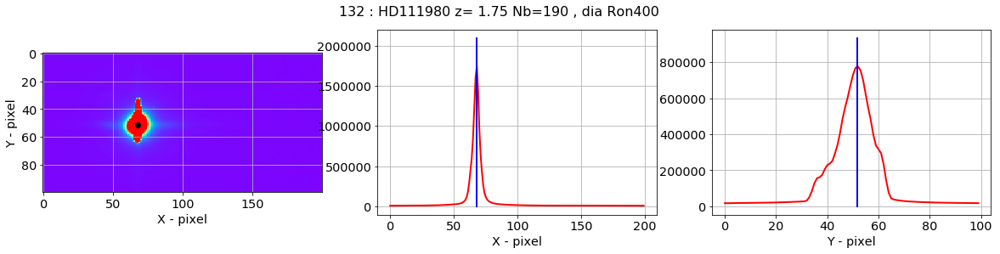

In [27]:
new_x_star,new_y_star=check_central_star(all_images,x_star0,y_star0,all_titles,all_filt)

## Zoom on the rotated image

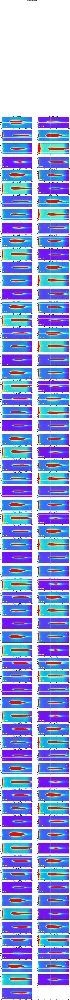

In [22]:
# Right spectrum
# start at star
y_star0=[all_images[0].shape[0]/2]*len(all_images)
x_star0=x_star
#ShowCenterImages([1300]*len(all_images),y_star0,[500]*len(all_images),[25]*len(all_images),
#                all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)
ShowCenterImages(x_star0+500,y_star0,[500]*len(all_images),[30]*len(all_images),
                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=1000)

title='Right part of spectrum of {} '.format(object_name)
plt.suptitle(title,size=16)
figfilename=os.path.join(dir_top_images,'rightorder.pdf')
plt.savefig(figfilename)  

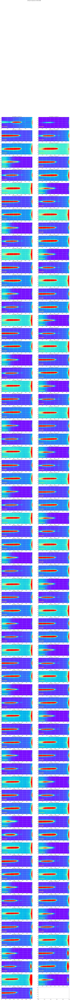

In [23]:
# Left spectrum
#--------------
y_star0=[all_images[0].shape[0]/2]*len(all_images)
x_star0=x_star-600

#ShowCenterImages([110]*len(all_images),[60]*len(all_images),[500]*len(all_images),[30]*len(all_images),
#                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)
ShowCenterImages(x_star0,y_star0,[600]*len(all_images),[30]*len(all_images),
                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=1000)
title='Left part of spectrum of {} '.format(object_name)
plt.suptitle(title,size=16)
figfilename=os.path.join(dir_top_images,'leftorder.pdf')
plt.savefig(figfilename)  


# Main emission/absorption lines in nm


In [24]:
for line in LINES:
    print line['label'],' \t lambda =' ,line['lambda']

$H\delta$  	 lambda = 410.2
$H\gamma$  	 lambda = 434.0
$He_{II}$  	 lambda = 468.6
$H\beta$  	 lambda = 486.3
$O_{III}$  	 lambda = 500.7
$C_{III}$  	 lambda = 570.0
$He_{I}$  	 lambda = 587.5
$H\alpha$  	 lambda = 656.3
$C_{III}$  	 lambda = 673.0
$C_{II}$  	 lambda = 679.0
$C_{IV}$  	 lambda = 706.0
$C_{II}$  	 lambda = 711.0
$C_{II}$  	 lambda = 723.5
$O_2$  	 lambda = 762.1
$H_2 O$  	 lambda = 960


# Plot one contour

In [25]:
def ShowOneContour(index,all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):

    plt.figure(figsize=(15,6))
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    YMIN=-15
    YMAX=15
    
    figfilename=os.path.join(dir_top_img,figname)   
    
    #center is approximately the one on the original raw image (may be changed)
    x0=int(all_pointing[index][0])
    
   
    
    # Extract the image    
    full_image=np.copy(all_images[index])
    
    # refine center in X,Y
    star_region_X=full_image[:,x0-star_halfwidth:x0+star_halfwidth]
    profile_X=np.sum(sub_image,axis=0)
    profile_Y=np.sum(sub_image,axis=1)

    X_=np.arange(NX)
    Y_=np.arange(NY)
    
    avX,sigX=weighted_avg_and_std(X_,profile_X**2) # take squared on purpose (weigh must be >0)
    avY,sigY=weighted_avg_and_std(Y_,profile_Y)
    
    x0=int(avX+x0-star_halfwidth)
      
    
    # find the center in Y on the spectrum
    yprofile=np.sum(full_image[:,spec_index_min:spec_index_max],axis=1)
    y0=np.where(yprofile==yprofile.max())[0][0]

    # cut the image in vertical and normalise by exposition time
    reduc_image=full_image[y0-20:y0+20,x0:spec_index_max]/all_expo[index] 
    reduc_image[:,0:100]=0  # erase central star
    
    X_Size_Pixels=np.arange(0,reduc_image.shape[1])
    Y_Size_Pixels=np.arange(0,reduc_image.shape[0])
    Transverse_Pixel_Size=Y_Size_Pixels-int(float(Y_Size_Pixels.shape[0])/2.)
    
    grating_name=all_filt[sel].replace('dia ','')
    holo = Hologram(grating_name,verbose=True)
    lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
        

    X,Y=np.meshgrid(lambdas,Transverse_Pixel_Size)     
    T=np.transpose(reduc_image)
        
        
    plt.contourf(X, Y, reduc_image, 20, alpha=.75, cmap='jet',origin='lower')
    C = plt.contour(X, Y, reduc_image , 20, colors='black', linewidth=.5,origin='lower')
        
    
    for line in LINES:
        if line == O2 or line == HALPHA or line == HBETA or line == HGAMMA:
            plt.plot([line['lambda'],line['lambda']],[YMIN,YMAX],'-',color='lime',lw=0.5)
            plt.text(line['lambda'],YMAX-3,line['label'],verticalalignment='bottom', horizontalalignment='center',color='lime', fontweight='bold',fontsize=16)
    
    
    
    plt.axis([X.min(), X.max(), Y.min(), Y.max()]); plt.grid(True)
    plt.title(all_titles[index])
    plt.grid(color='white', ls='solid')
    plt.text(100,-5.,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
    plt.xlabel('$\lambda$ (nm)')
    plt.ylabel('pixels')
    plt.ylim(YMIN,YMAX)
    plt.xlim(0.,1200.)
    plt.savefig(figfilename)


In [26]:
def ShowOneContourOld(index,all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):

    plt.figure(figsize=(15,6))
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    YMIN=-15
    YMAX=15
    
    figfilename=os.path.join(dir_top_img,figname)   
    
    #center is approximately the one on the original raw image (may be changed)
    x0=int(all_pointing[index][0])
    
   
    
    # Extract the image    
    full_image=np.copy(all_images[index])
    
    # refine center in X,Y
    star_region_X=full_image[:,x0-star_halfwidth:x0+star_halfwidth]
    profile_X=np.sum(sub_image,axis=0)
    profile_Y=np.sum(sub_image,axis=1)

    X_=np.arange(NX)
    Y_=np.arange(NY)
    
    avX,sigX=weighted_avg_and_std(X_,profile_X)
    avY,sigY=weighted_avg_and_std(Y_,profile_Y)
    
    x0=int(avX+x0-star_halfwidth)
      
    
    # find the center in Y
    yprofile=np.sum(full_image[:,spec_index_min:spec_index_max],axis=1)
    y0=np.where(yprofile==yprofile.max())[0][0]

    # cut the image in vertical and normalise by exposition time
    reduc_image=full_image[y0-20:y0+20,x0:spec_index_max]/all_expo[index] 
    reduc_image[:,0:100]=0  # erase central star
    
    X_Size_Pixels=np.arange(0,reduc_image.shape[1])
    Y_Size_Pixels=np.arange(0,reduc_image.shape[0])
    Transverse_Pixel_Size=Y_Size_Pixels-int(float(Y_Size_Pixels.shape[0])/2.)
    
    grating_name=all_filt[sel].replace('dia ','')
    holo = Hologram(grating_name,verbose=True)
    lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
        
    #X,Y=np.meshgrid(lambdas,Y_Size_Pixels)  
    #X,Y=np.meshgrid(X_Size_Pixels,Y_Size_Pixels)  
    X,Y=np.meshgrid(lambdas,Transverse_Pixel_Size)     
    T=np.transpose(reduc_image)
        
        #im = axarr[iy,ix].pcolormesh(X,Y,reduc_image, cmap='rainbow',vmin=0,vmax=themax*0.5)    # pcolormesh is impracticalble in pdf file 
    plt.contourf(X, Y, reduc_image, 20, alpha=.75, cmap='jet',origin='lower')
    C = plt.contour(X, Y, reduc_image , 20, colors='black', linewidth=.5,origin='lower')
        
    
    for line in LINES:
        if line == O2 or line == HALPHA or line == HBETA or line == HGAMMA:
            plt.plot([line['lambda'],line['lambda']],[YMIN,YMAX],'-',color='lime',lw=0.5)
            plt.text(line['lambda'],YMAX-3,line['label'],verticalalignment='bottom', horizontalalignment='center',color='lime', fontweight='bold',fontsize=16)
    
    
    
    plt.axis([X.min(), X.max(), Y.min(), Y.max()]); plt.grid(True)
    plt.title(all_titles[index])
    plt.grid(color='white', ls='solid')
    plt.text(100,-5.,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
    plt.xlabel('$\lambda$ (nm)')
    plt.ylabel('pixels')
    plt.ylim(YMIN,YMAX)
    plt.xlim(0.,1200.)
    plt.savefig(figfilename)


Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


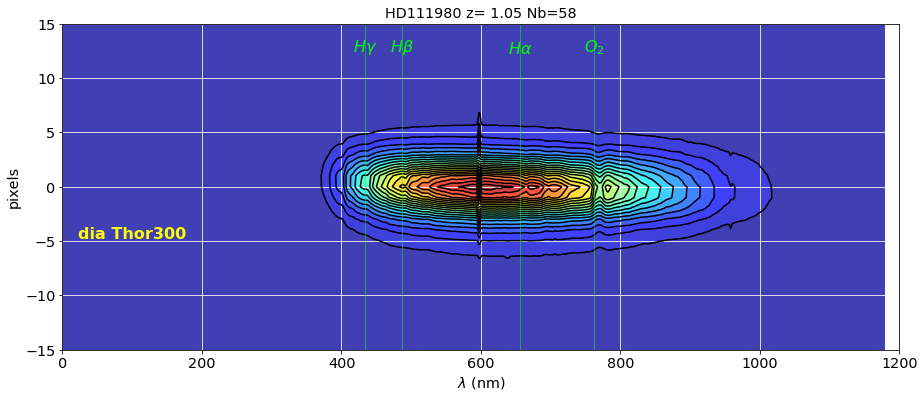

In [27]:
sel=0
ShowOneContour(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'contour_thor300_1.pdf')

Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


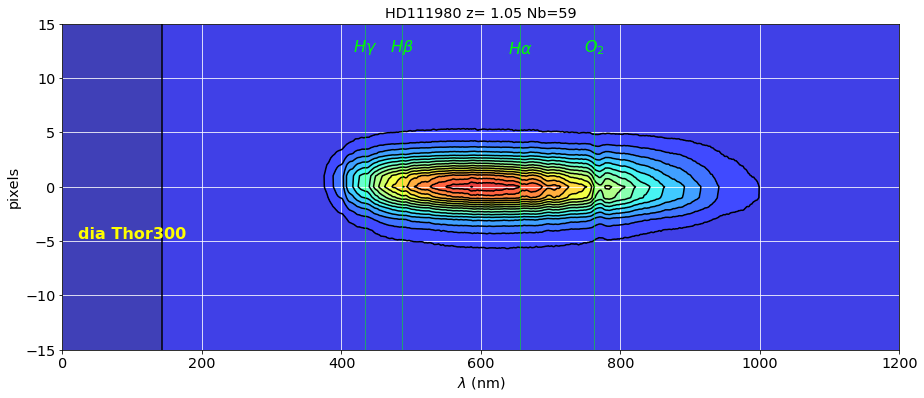

In [28]:
sel=1
ShowOneContour(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'contour_thor300_2.pdf')

Load hologram Ron400:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.3 degrees
Hologram center at x0 = 741.0 and y0 = 741.0 with average tilt of -0.3 degrees
Order  0 position at x0 = 435.0 and y0 = 742.5
Order +1 position at x0 = 1047.0 and y0 = 739.5
Distance between the orders: 611.97 pixels (14.69 mm)


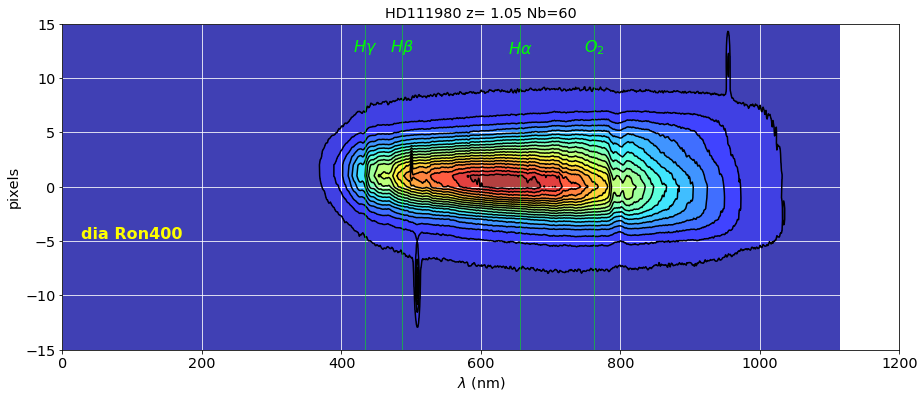

In [29]:
sel=2
ShowOneContour(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'contour_ron400.pdf')

Load hologram HoloPhP:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.0 degrees
Hologram center at x0 = 856.0 and y0 = 562.3 with average tilt of -1.0 degrees
Order  0 position at x0 = 590.7 and y0 = 567.2
Order +1 position at x0 = 1121.3 and y0 = 557.5
Distance between the orders: 530.76 pixels (12.74 mm)


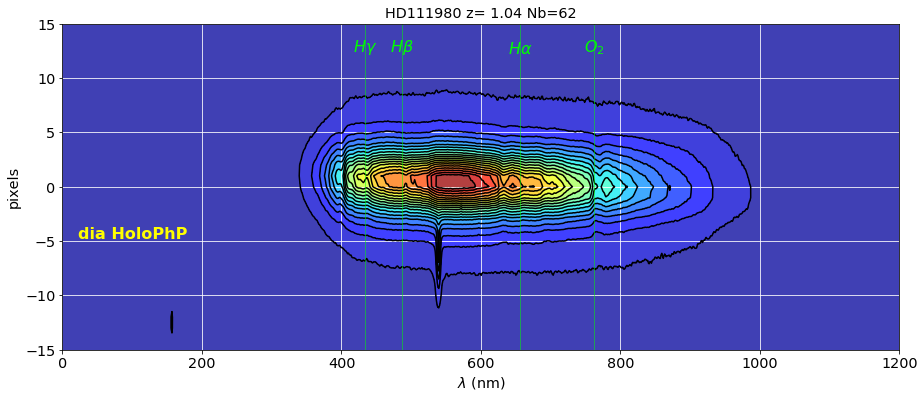

In [30]:
sel=4
ShowOneContour(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'contour_holophp.pdf')

Load hologram HoloPhAg:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.9 degrees
Hologram center at x0 = 1044.2 and y0 = 606.7 with average tilt of -1.9 degrees
Order  0 position at x0 = 779.6 and y0 = 614.7
Order +1 position at x0 = 1308.7 and y0 = 598.7
Distance between the orders: 529.36 pixels (12.70 mm)


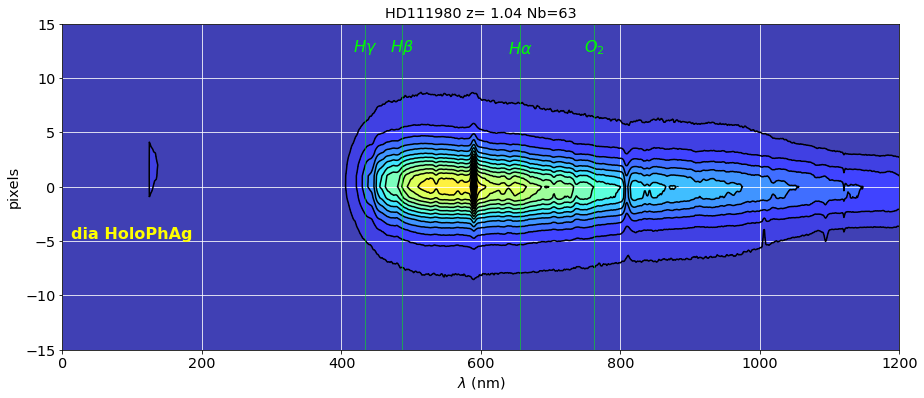

In [31]:
sel=5
ShowOneContour(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'contour_holophag.pdf')

Load hologram HoloAmAg:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.9 degrees
Hologram center at x0 = 1070.9 and y0 = 586.1 with average tilt of -1.9 degrees
Order  0 position at x0 = 805.1 and y0 = 595.0
Order +1 position at x0 = 1336.6 and y0 = 577.3
Distance between the orders: 531.79 pixels (12.76 mm)


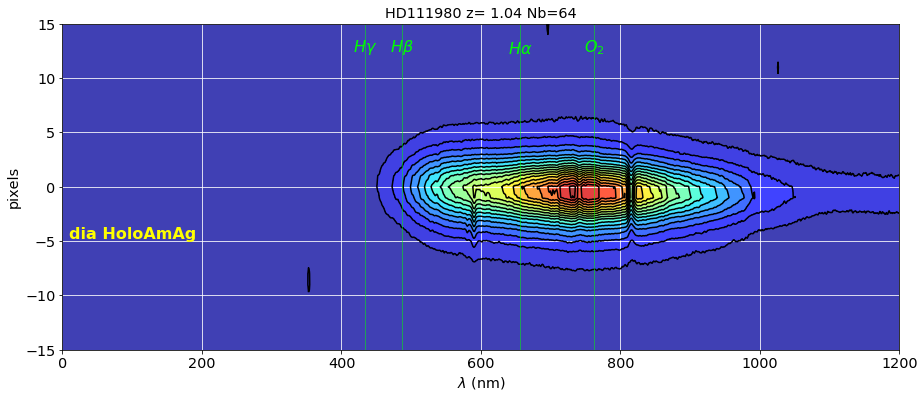

In [32]:
sel=6
ShowOneContour(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'contour_holoamag.pdf')

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import os
import math as m

from matplotlib.backends.backend_pdf import PdfPages   



def ShowOneOrder_contour(all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):
    """
    ShowRawImages_contour: Show the raw images without background subtraction
    ==============
    """
    NBIMGPERROW=2
    NBIMAGES=len(all_images)
    MAXIMGROW=max(2,m.ceil(NBIMAGES/NBIMGPERROW))
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    
    YMIN=-10
    YMAX=10
    
    figfilename=os.path.join(dir_top_img,figname)   
    title='Images of {}'.format(object_name)
    
    
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,figname)
    pp = PdfPages(figfilename) # create a pdf file
    
    
    for index in np.arange(0,NBIMAGES):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
         
        
        
        #center is approximately the one on the original raw image (may be changed)
        x0=int(all_pointing[index][0])
        
        
        # Extract the image    
        full_image=np.copy(all_images[index])
        
        # refine center in X,Y
        star_region_X=full_image[:,x0-star_halfwidth:x0+star_halfwidth]
        profile_X=np.sum(sub_image,axis=0)
        profile_Y=np.sum(sub_image,axis=1)

        X_=np.arange(NX)
        Y_=np.arange(NY)
    
        avX,sigX=weighted_avg_and_std(X_,profile_X**2) # take squared on purpose (weigh must be >0)
        avY,sigY=weighted_avg_and_std(Y_,profile_Y)
    
        x0=int(avX+x0-star_halfwidth)
        
        
    
        # find the center in Y
        yprofile=np.sum(full_image[:,spec_index_min:spec_index_max],axis=1)
        y0=np.where(yprofile==yprofile.max())[0][0]
        

        # cut the image
        # the origin is the is the star center
        reduc_image=full_image[y0-20:y0+20,x0:spec_index_max]/all_expo[index] 
        
        if(all_expo[index]>=0 ): 
            reduc_image=reduc_image/all_expo[index] 
            
        reduc_image[:,0:100]=0  # erase central star
    
   
    
        X_Size_Pixels=np.arange(0,reduc_image.shape[1])
        Y_Size_Pixels=np.arange(0,reduc_image.shape[0])
        
        Transverse_Pixel_Size=Y_Size_Pixels-int(float(Y_Size_Pixels.shape[0])/2.)
    
        grating_name=all_filt[sel].replace('dia ','')
        holo = Hologram(grating_name,verbose=False)
        lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
        
    
        X,Y=np.meshgrid(lambdas,Transverse_Pixel_Size)     
        T=np.transpose(reduc_image)
                   
        themax=(reduc_image.flatten()).max()    
            
        
        
        axarr[iy,ix].contourf(X, Y, reduc_image, 10, alpha=.75, cmap='jet')
        C = axarr[iy,ix].contour(X, Y, reduc_image , 10, colors='black', linewidth=.5)
        
        for line in LINES:
            if line == O2 or line == HALPHA or line == HBETA or line == HGAMMA:
                axarr[iy,ix].plot([line['lambda'],line['lambda']],[YMIN,YMAX],'-',color='lime',lw=0.5)
                axarr[iy,ix].text(line['lambda'],YMAX-3,line['label'],verticalalignment='bottom', horizontalalignment='center',color='lime', fontweight='bold',fontsize=16)
        
        
        axarr[iy,ix].axis([X.min(), X.max(), Y.min(), Y.max()]); 
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_title(all_titles[index])
    
        axarr[iy,ix].grid(color='white', ls='solid')
        axarr[iy,ix].text(100,-5.,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
        
        
        axarr[iy,ix].set_xlabel('$\lambda$ (nm)')
        axarr[iy,ix].set_ylabel('pixels')
        axarr[iy,ix].set_ylim(YMIN,YMAX)
        axarr[iy,ix].set_xlim(0.,1100.)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            print "pdf Page written ",PageNum
            f.show()
        
          
    
    f.savefig(pp, format='pdf') 
    print "Final pdf Page written ",PageNum
    f.show()
    pp.close()  



In [34]:
import numpy as np
import matplotlib.pyplot as plt
import os
import math as m

from matplotlib.backends.backend_pdf import PdfPages   



def ShowOneOrder_contourOld(all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):
    """
    ShowRawImages_contour: Show the raw images without background subtraction
    ==============
    """
    NBIMGPERROW=2
    NBIMAGES=len(all_images)
    MAXIMGROW=max(2,m.ceil(NBIMAGES/NBIMGPERROW))
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    
    YMIN=-10
    YMAX=10
    
    figfilename=os.path.join(dir_top_img,figname)   
    title='Images of {}'.format(object_name)
    
    
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,figname)
    pp = PdfPages(figfilename) # create a pdf file
    
    
    for index in np.arange(0,NBIMAGES):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        
       
        
        
        #center is approximately the one on the original raw image (may be changed)
        x0=int(all_pointing[index][0])
        x0_old=x0 
   
    
        # Extract the image    
        full_image=np.copy(all_images[index])
    
        # refine center in X
        star_region=np.sum(full_image[:,x0-star_halfwidth:x0+star_halfwidth],axis=0)
        x0=np.where(star_region==star_region.max())[0][0]+x0-star_halfwidth
        x0_new=x0
    
        dx= x0_new-x0_old
        print index,' dx=',dx
        
        if np.abs(dx)>10:
            x0=x0_old
    
        # find the center in Y
        yprofile=np.sum(full_image[:,spec_index_min:spec_index_max],axis=1)
        y0=np.where(yprofile==yprofile.max())[0][0]
        

        # cut the image
        reduc_image=full_image[y0-20:y0+20,x0:spec_index_max]/all_expo[index] 
        
        if(all_expo[index]>=0 ): 
            reduc_image=reduc_image/all_expo[index] 
            
        reduc_image[:,0:100]=0  # erase central star
    
   
    
        X_Size_Pixels=np.arange(0,reduc_image.shape[1])
        Y_Size_Pixels=np.arange(0,reduc_image.shape[0])
        Transverse_Pixel_Size=Y_Size_Pixels-int(float(Y_Size_Pixels.shape[0])/2.)
    
        grating_name=all_filt[sel].replace('dia ','')
        holo = Hologram(grating_name,verbose=False)
        lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
        
    
        X,Y=np.meshgrid(lambdas,Transverse_Pixel_Size)     
        T=np.transpose(reduc_image)
        
    
            
        themax=(reduc_image.flatten()).max()    
            
        
        #im = axarr[iy,ix].pcolormesh(X,Y,reduc_image, cmap='rainbow',vmin=0,vmax=themax*0.5)    # pcolormesh is impracticalble in pdf file 
        axarr[iy,ix].contourf(X, Y, reduc_image, 10, alpha=.75, cmap='jet')
        C = axarr[iy,ix].contour(X, Y, reduc_image , 10, colors='black', linewidth=.5)
        
        for line in LINES:
            if line == O2 or line == HALPHA or line == HBETA or line == HGAMMA:
                axarr[iy,ix].plot([line['lambda'],line['lambda']],[YMIN,YMAX],'-',color='lime',lw=0.5)
                axarr[iy,ix].text(line['lambda'],YMAX-3,line['label'],verticalalignment='bottom', horizontalalignment='center',color='lime', fontweight='bold',fontsize=16)
        
        
        axarr[iy,ix].axis([X.min(), X.max(), Y.min(), Y.max()]); axarr[iy,ix].grid(True)
        axarr[iy,ix].set_title(all_titles[index])
    
        axarr[iy,ix].grid(color='white', ls='solid')
        axarr[iy,ix].text(100,-5.,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
        
        
        axarr[iy,ix].set_xlabel('$\lambda$ (nm)')
        axarr[iy,ix].set_ylabel('pixels')
        axarr[iy,ix].set_ylim(YMIN,YMAX)
        axarr[iy,ix].set_xlim(0.,1100.)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            print "pdf Page written ",PageNum
            f.show()
        
          
    
    f.savefig(pp, format='pdf') 
    print "Final pdf Page written ",PageNum
    f.show()
    pp.close()  

0  dx= 1
1  dx= 1
2  dx= 32
3  dx= 1
4  dx= 2
5  dx= 34
6  dx= 34
7  dx= 2
8  dx= 2
9  dx= 2
pdf Page written  1
10  dx= 4
11  dx= 3
12  dx= 1
13  dx= 2
14  dx= 2
15  dx= 3
16  dx= 3
17  dx= 2
18  dx= 2
19  dx= 2
pdf Page written  2
20  dx= 3
21  dx= 3
22  dx= 1
23  dx= 2
24  dx= 1
25  dx= 3
26  dx= 3
27  dx= 1
28  dx= 2
29  dx= 2
pdf Page written  3
30  dx= 3
31  dx= 3
32  dx= 1
33  dx= 2
34  dx= 2
35  dx= 4
36  dx= 3
37  dx= 1
38  dx= 2
39  dx= 2
pdf Page written  4
40  dx= 3
41  dx= 3
42  dx= 1
43  dx= 2
44  dx= 2
45  dx= 3
46  dx= 3
47  dx= 2
48  dx= 2
49  dx= 2
pdf Page written  5
50  dx= 3
51  dx= 3
52  dx= 2
53  dx= 2
54  dx= 2
55  dx= 4
56  dx= 3
57  dx= 2
58  dx= 2
59  dx= 2
pdf Page written  6
60  dx= 3
61  dx= 3
62  dx= 2
63  dx= 1
64  dx= 2
65  dx= 4
66  dx= 3
67  dx= 2
68  dx= 2
69  dx= 2
pdf Page written  7
70  dx= 4
71  dx= 3
72  dx= 2
73  dx= 2
74  dx= 2
75  dx= 3
76  dx= 3
77  dx= 1
78  dx= 2
79  dx= 2
pdf Page written  8
80  dx= 4
81  dx= 3
82  dx= 2
83  dx= 2
84  dx=

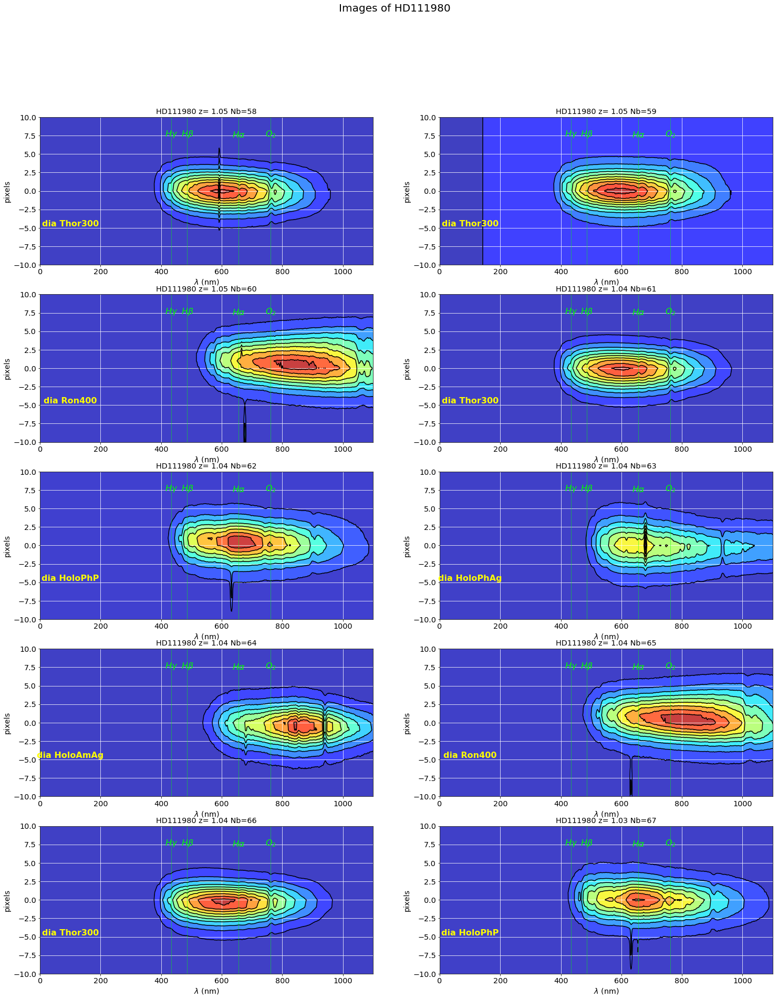

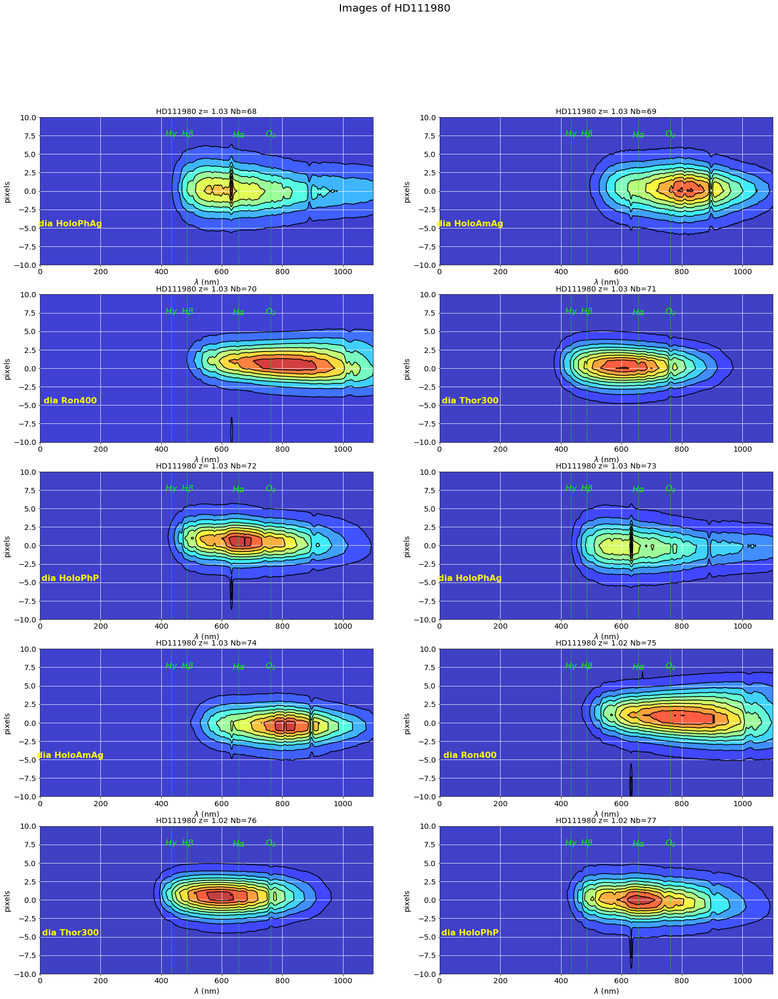

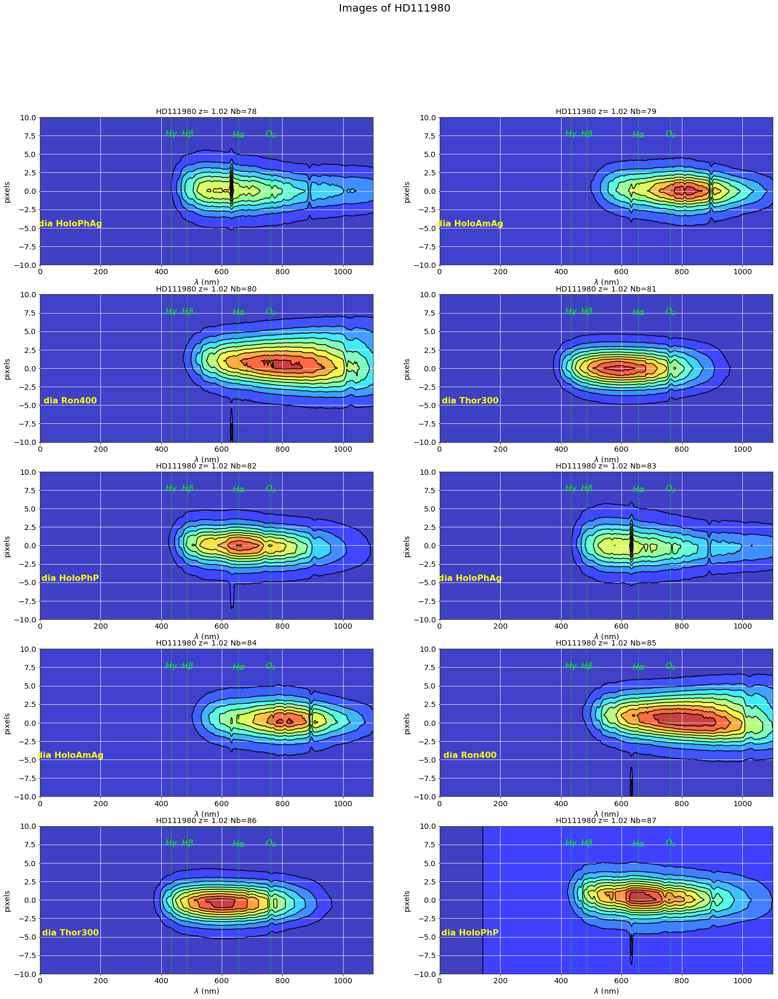

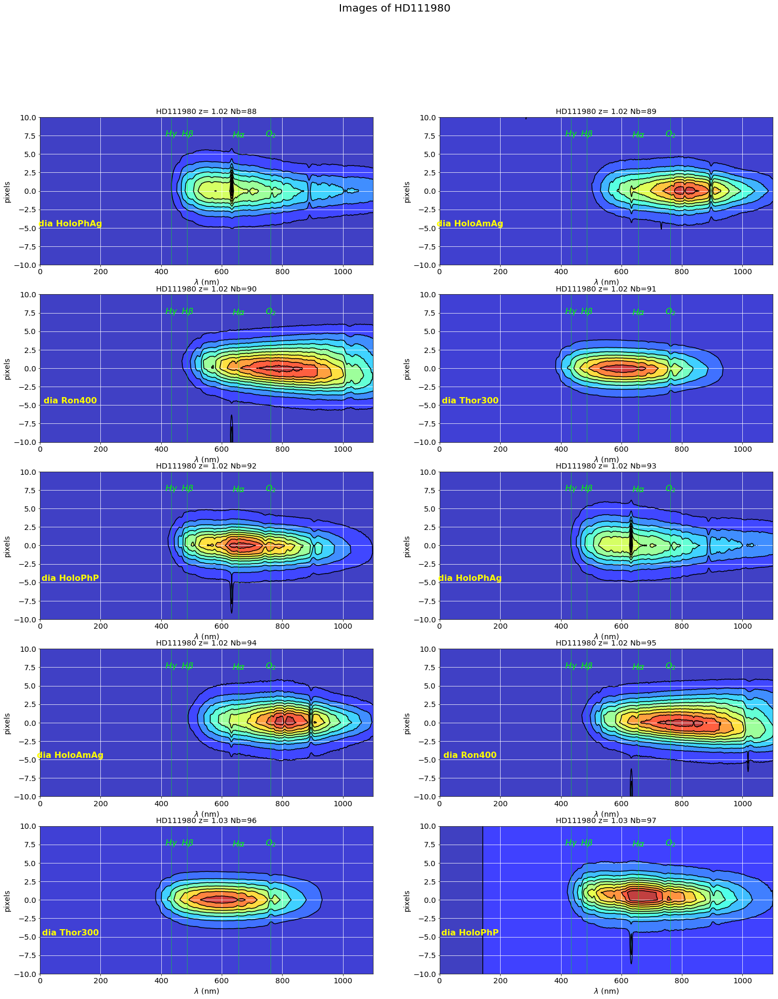

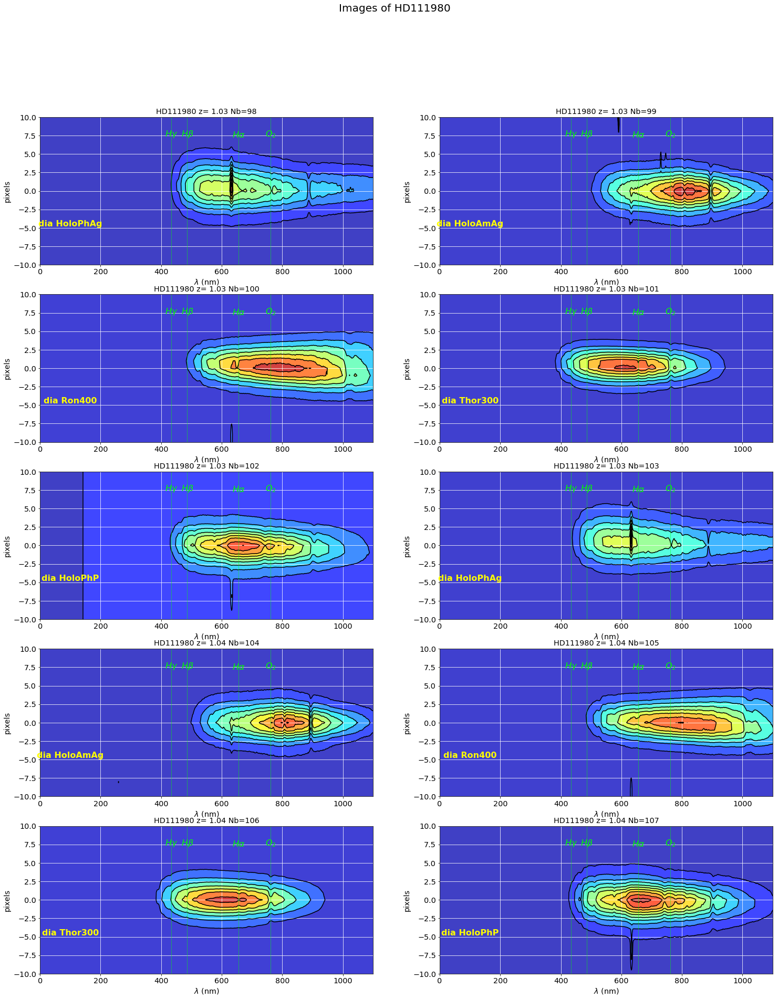

...

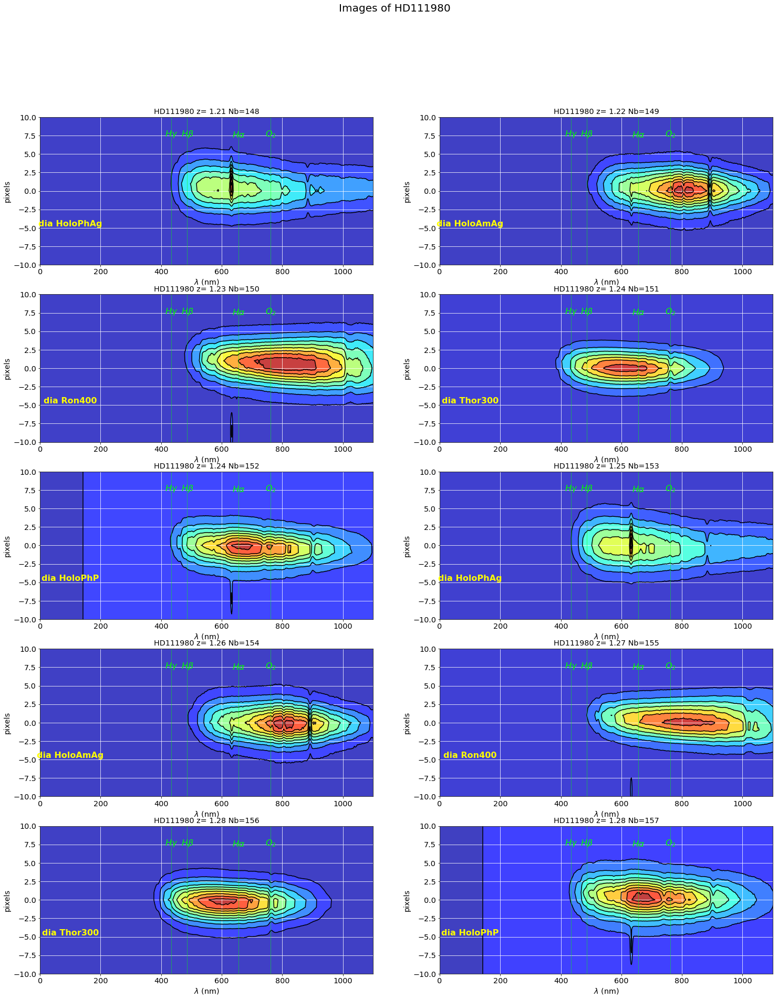

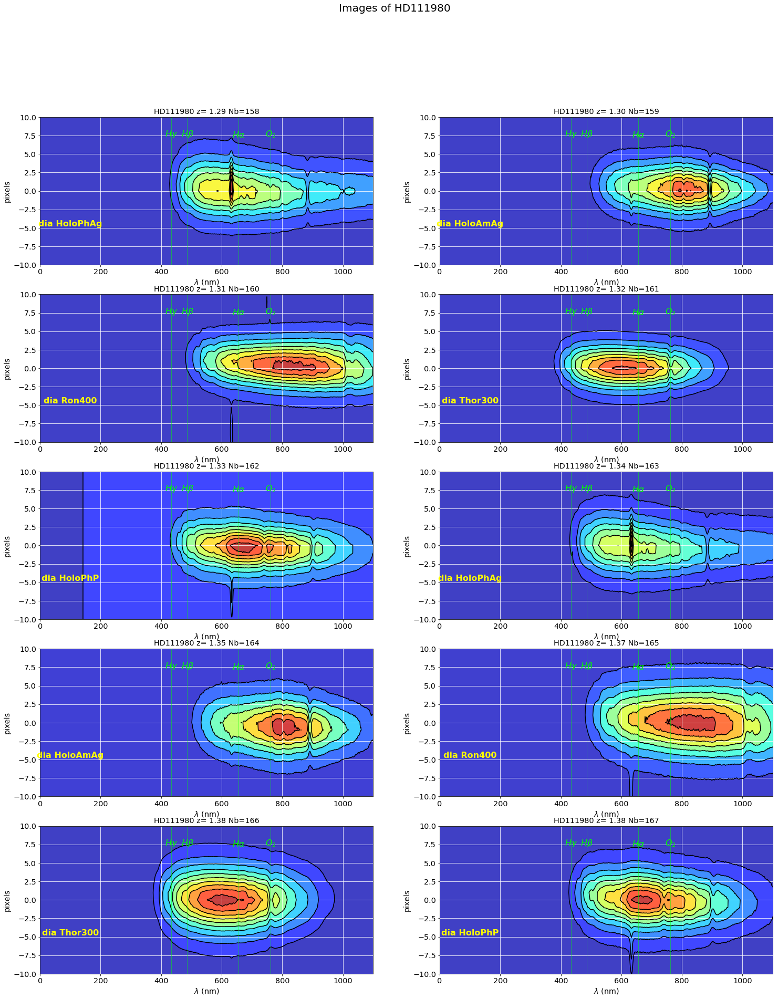

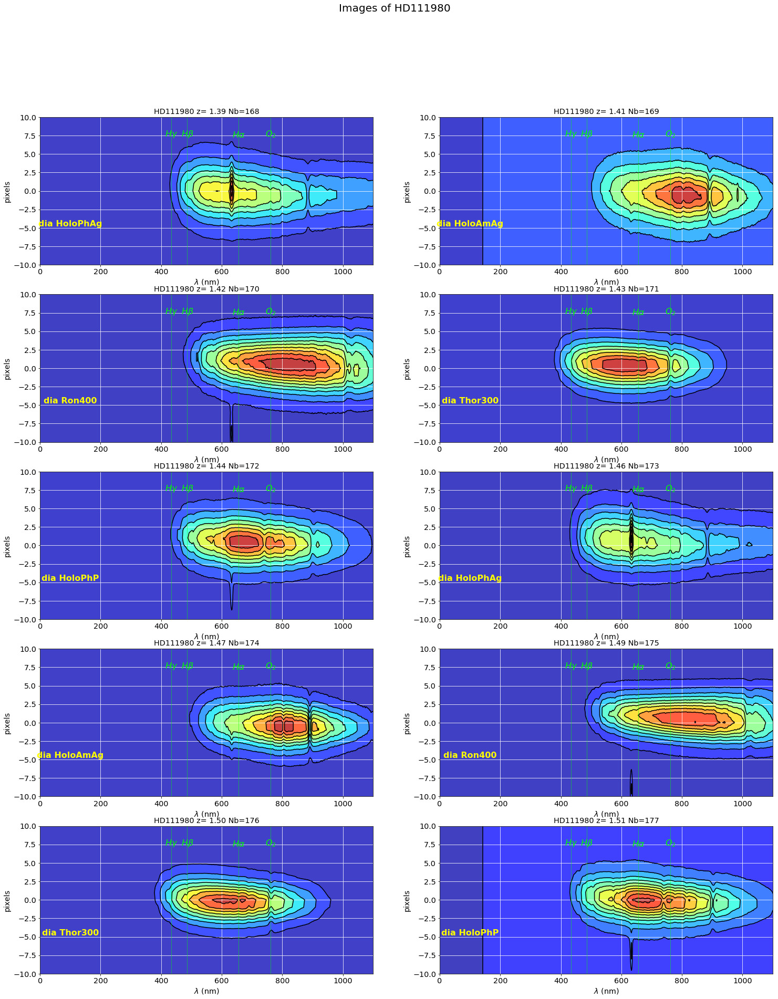

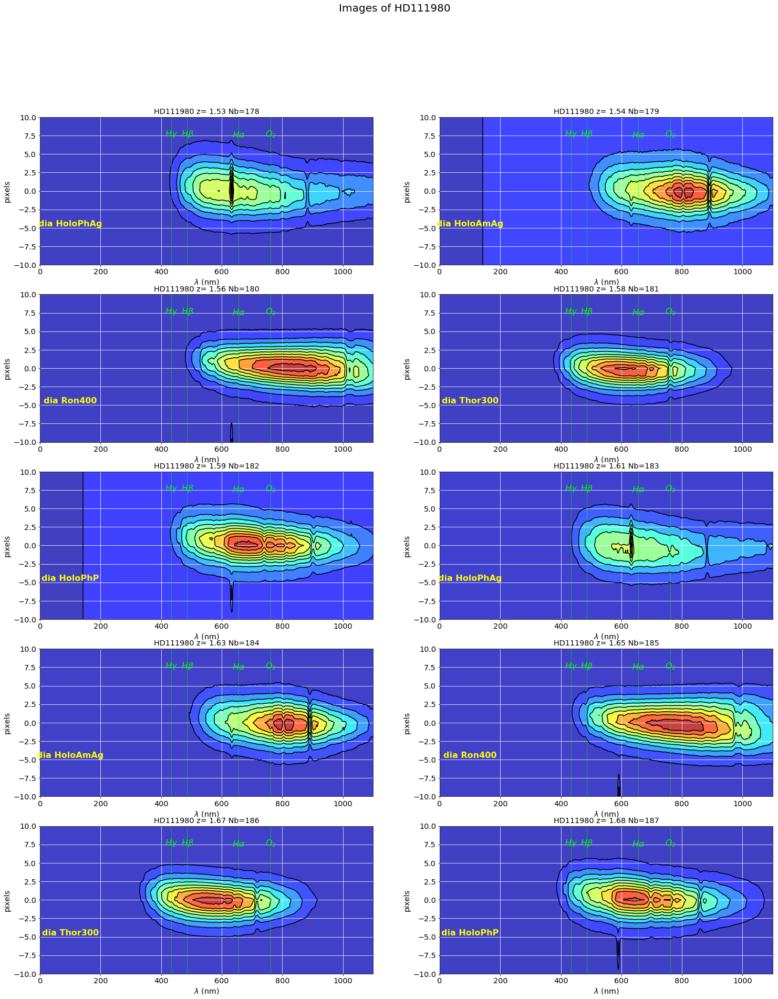

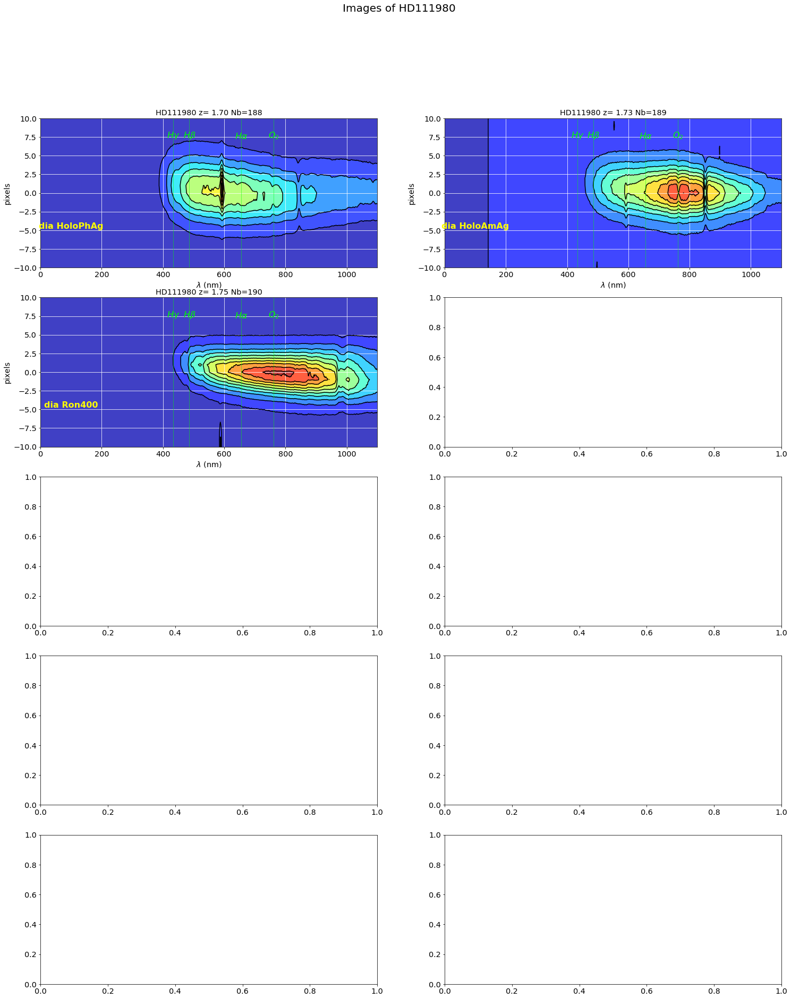

In [66]:
ShowOneOrder_contourOld(all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'firstorderright_contour.pdf')

## Test which transverse spectrum

In [36]:
def ShowManyTransverseSpectrum(index,all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):

    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    wlmin=np.array([400,500,600,700,800,900.])
    wlmax=np.array([500,600,700,800,900,1000.])
    
    #wlmin=np.array([400,450,500,550,600,650,700,750,800,850,900,950])
    #wlmax=np.array([450,500,550,600,650,700,750,800,850,900,950,1000])
    
   
    
    NBANDS=wlmin.shape[0]
    
    figfilename=os.path.join(dir_top_img,figname)  
    plt.figure(figsize=(16,6))
    
    
    x0=int(all_pointing[index][0])
    y0=int(all_pointing[index][1])
    
    thetitle=all_titles[index]+' '+all_filt[index]
        
    full_image=np.copy(all_images[index])
    
    
    # subsample of the image (left part)
    reduc_image=full_image[:,x0:]/all_expo[index] 
    reduc_image[:,0:100]=0  # erase central star
        
    yprofile=np.sum(reduc_image,axis=1)
    yy0=np.where(yprofile==yprofile.max())[0][0]    
        
    
    # wavelength calibration
    X_Size_Pixels=np.arange(0,reduc_image.shape[1])
    Y_Size_Pixels=np.arange(0,reduc_image.shape[0]) 
    DY_Size_Pixels=Y_Size_Pixels-yy0
   
   
    grating_name=all_filt[sel].replace('dia ','')
    holo = Hologram(grating_name,verbose=True)
    lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
    
    all_Yprofile = []
    all_fwhm = []
    
    for band in np.arange(NBANDS):
        iband=band
        w1=wlmin[iband]
        w2=wlmax[iband]
        Xpixel_range=np.where(np.logical_and(lambdas>w1,lambdas<w2))[0]
        sub_image=np.copy(reduc_image[:,Xpixel_range])
        sub_yprofile=np.sum(sub_image,axis=1)
        mean,sig=weighted_avg_and_std(DY_Size_Pixels,sub_yprofile**2)
        
        all_Yprofile.append(sub_yprofile)
        label="$\lambda$ = {:3.0f}-{:3.0f}nm, $fwhm=$ {:2.1f} pix".format(w1,w2,2.36*sig)
        all_fwhm.append(2.36*sig)
        plt.plot(DY_Size_Pixels,sub_yprofile,'-',label=label,lw=2)
        
    plt.title(thetitle) 
    plt.grid(color='grey', ls='solid')
    plt.legend(loc=1)
    plt.xlim(-30.,30.)
    plt.savefig(figfilename)
    
    all_fwhm=np.array(all_fwhm)
    wl_average=np.average([wlmin,wlmax],axis=0)
    
    return wl_average,all_fwhm



Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


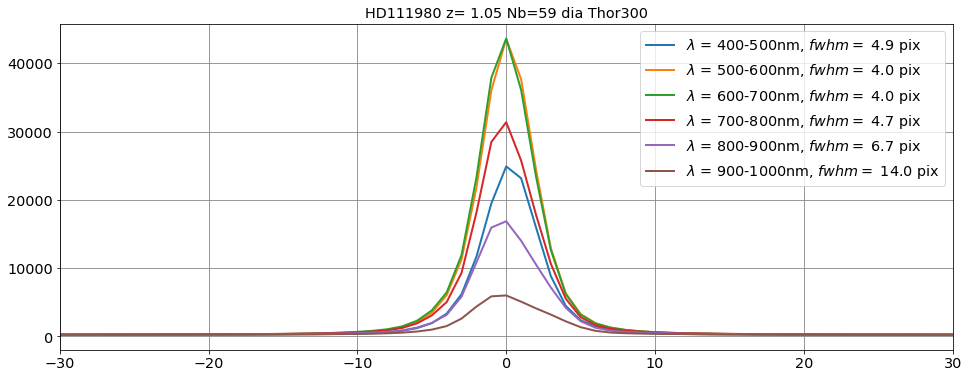

In [37]:
sel=1
w0,fwhm0=ShowManyTransverseSpectrum(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'transverse_thor300.pdf')

Load hologram Ron400:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.3 degrees
Hologram center at x0 = 741.0 and y0 = 741.0 with average tilt of -0.3 degrees
Order  0 position at x0 = 435.0 and y0 = 742.5
Order +1 position at x0 = 1047.0 and y0 = 739.5
Distance between the orders: 611.97 pixels (14.69 mm)


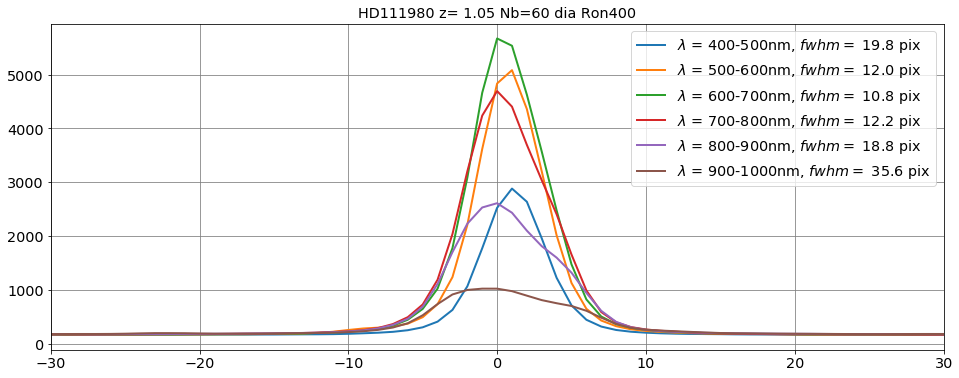

In [38]:
sel=2
w1,fwhm1=ShowManyTransverseSpectrum(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'transverse_ron400.pdf')

Load hologram HoloPhP:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.0 degrees
Hologram center at x0 = 856.0 and y0 = 562.3 with average tilt of -1.0 degrees
Order  0 position at x0 = 590.7 and y0 = 567.2
Order +1 position at x0 = 1121.3 and y0 = 557.5
Distance between the orders: 530.76 pixels (12.74 mm)


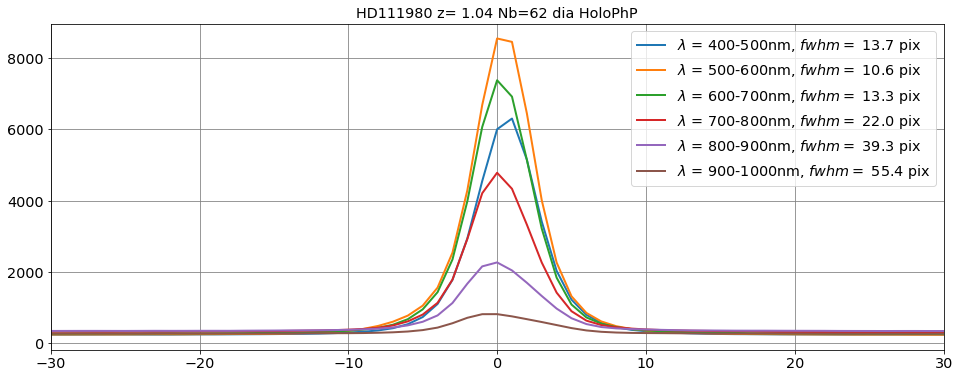

In [39]:
sel=4
w1,fwhm1=ShowManyTransverseSpectrum(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'transverse_holophp.pdf')

Load hologram HoloPhAg:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.9 degrees
Hologram center at x0 = 1044.2 and y0 = 606.7 with average tilt of -1.9 degrees
Order  0 position at x0 = 779.6 and y0 = 614.7
Order +1 position at x0 = 1308.7 and y0 = 598.7
Distance between the orders: 529.36 pixels (12.70 mm)


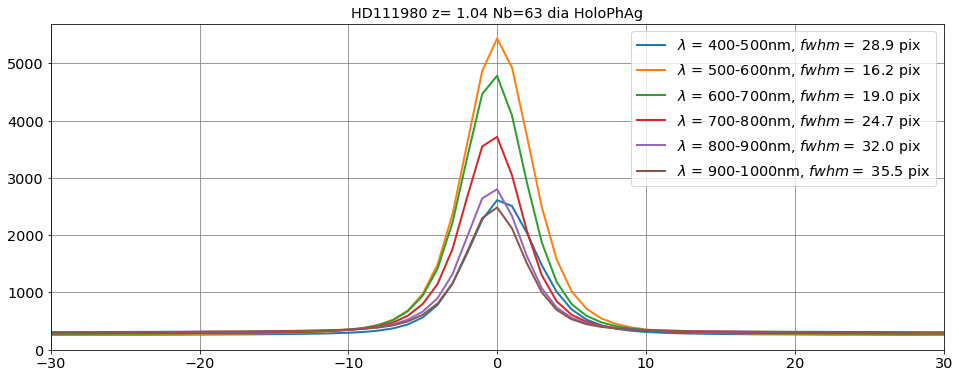

In [40]:
sel=5
w2,fwhm2=ShowManyTransverseSpectrum(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'transverse_holophag.pdf')

Load hologram HoloAmAg:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.9 degrees
Hologram center at x0 = 1070.9 and y0 = 586.1 with average tilt of -1.9 degrees
Order  0 position at x0 = 805.1 and y0 = 595.0
Order +1 position at x0 = 1336.6 and y0 = 577.3
Distance between the orders: 531.79 pixels (12.76 mm)


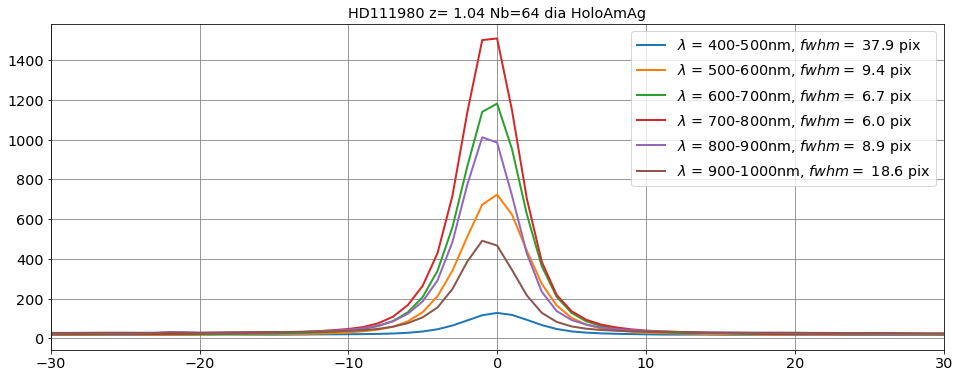

In [41]:
sel=6
w3,fwhm3=ShowManyTransverseSpectrum(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'transverse_holoamag.pdf')

## Summary on fwhm 

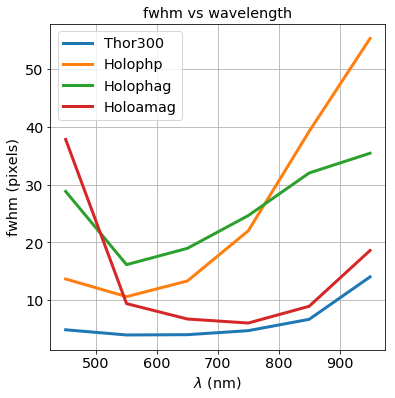

In [42]:
plt.figure(figsize=(6,6))
NBINS=w0.shape[0]
plt.plot(w0,fwhm0,'-',label='Thor300',lw=3)
plt.plot(w1,fwhm1,'-',label='Holophp',lw=3)
plt.plot(w2,fwhm2,'-',label='Holophag',lw=3)
plt.plot(w3,fwhm3,'-',label='Holoamag',lw=3)
plt.grid()
plt.xlabel('$\lambda$ (nm)')
plt.ylabel('fwhm (pixels)')
plt.title('fwhm vs wavelength')
plt.legend(loc=2)
figname='fwhm_vs_lambdas_{}.pdf'.format(NBINS)
figfilename=os.path.join(dir_top_images,figname)  
plt.savefig(figfilename)

## Longitudinal spectrum versus transverse width

In [43]:
def ShowLongitudinalSpectraSelection(index,all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):
    """
    """
    plt.figure(figsize=(15,6))
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    wsel_set=np.array([1.,3.,5.,7.,10.])
    NBSEL=wsel_set.shape[0]
    
    #x0=int(x_pointing[index])
    x0=int(all_pointing[index][0])
    
    figfilename=os.path.join(dir_top_img,figname)   
        
      
    thetitle=all_titles[index]+' '+all_filt[index]   
    
    
    full_image=np.copy(all_images[index])
    yprofile=np.sum(full_image[:,spec_index_min:spec_index_max],axis=1)
    y0=np.where(yprofile==yprofile.max())[0][0]

    reduc_image=full_image[y0-20:y0+20,x0:spec_index_max]/all_expo[index] 
    reduc_image[:,0:100]=0  # erase central star
    
    X_Size_Pixels=np.arange(0,reduc_image.shape[1])
    Y_Size_Pixels=np.arange(0,reduc_image.shape[0])
    Transverse_Pixel_Size=Y_Size_Pixels-int(float(Y_Size_Pixels.shape[0])/2.)
    
    
    grating_name=all_filt[sel].replace('dia ','')
    holo = Hologram(grating_name,verbose=True)
    lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
    
    all_longitudinal_profile = []
    all_max = []
    for thewsel in wsel_set:
                
        y_indexsel=np.where(np.abs(Transverse_Pixel_Size)<=thewsel)[0]
                
        
        longitudinal_profile2d=np.copy(reduc_image[y_indexsel,:])
        
        longitudinal_profile1d=np.sum(longitudinal_profile2d,axis=0)
        all_max.append(np.max(longitudinal_profile1d))
        
        all_longitudinal_profile.append(longitudinal_profile1d)
        
        thelabel=' abs(y) < {} '.format(thewsel)
        
        plt.plot(lambdas,longitudinal_profile1d,'-',label=thelabel,lw=2)
        
    all_max=np.array(all_max)
    themax=np.max(all_max)
    
    YMIN=0.
    YMAX=1.2*themax
    
    for line in LINES:
        if line == O2 or line == HALPHA or line == HBETA or line == HGAMMA or line == HDELTA:
            plt.plot([line['lambda'],line['lambda']],[YMIN,YMAX],'-',color='red',lw=0.5)
            plt.text(line['lambda'],0.9*(YMAX-YMIN),line['label'],verticalalignment='bottom', horizontalalignment='center',color='red', fontweight='bold',fontsize=16)
    
    
    plt.title(thetitle)
   
    
    plt.grid(color='grey', ls='solid')
    #plt.text(100,-5.,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
    plt.xlabel('$\lambda$ (nm)')
    plt.ylabel('Intensity')
    
    plt.xlim(0.,1200.)
    plt.ylim(0.,YMAX)
    plt.legend(loc=1)
    plt.savefig(figfilename)



Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


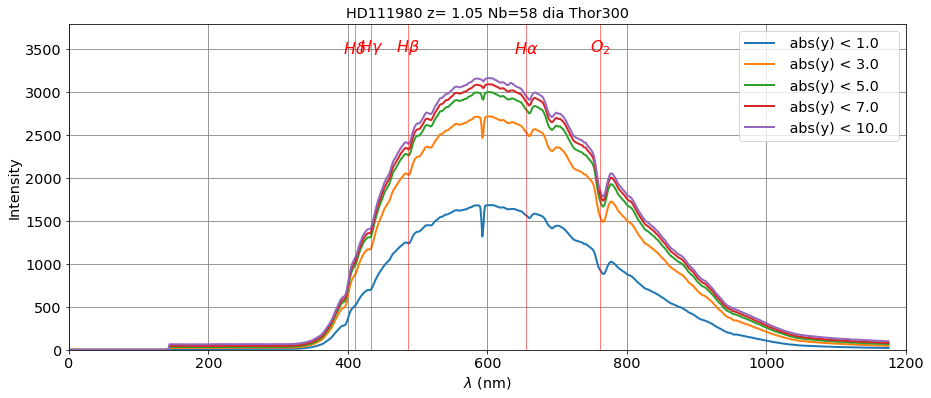

In [44]:
sel=0
ShowLongitudinalSpectraSelection(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_thor300.pdf')

Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


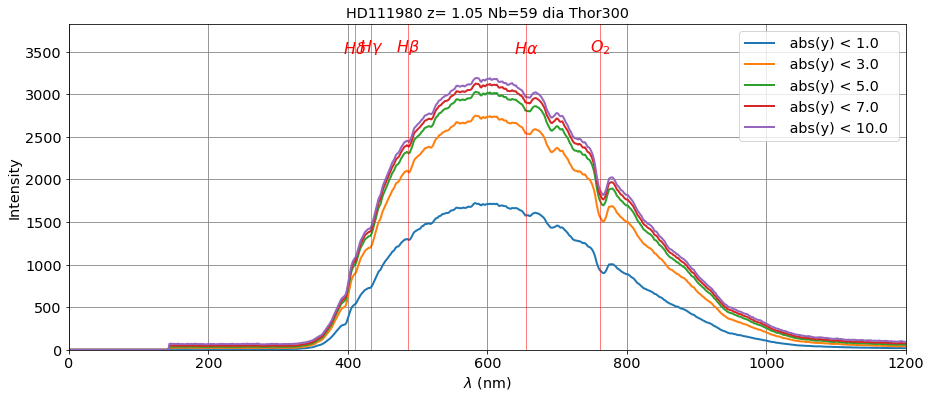

In [45]:
sel=1
ShowLongitudinalSpectraSelection(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_holophp.pdf')

Load hologram Ron400:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.3 degrees
Hologram center at x0 = 741.0 and y0 = 741.0 with average tilt of -0.3 degrees
Order  0 position at x0 = 435.0 and y0 = 742.5
Order +1 position at x0 = 1047.0 and y0 = 739.5
Distance between the orders: 611.97 pixels (14.69 mm)


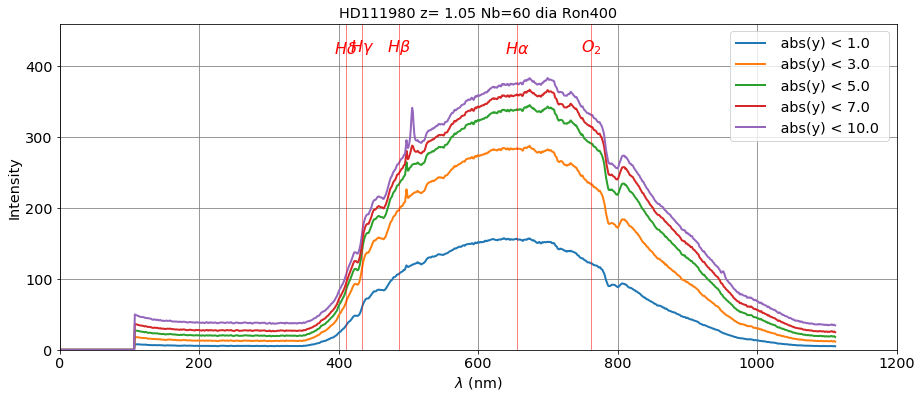

In [46]:
sel=2
ShowLongitudinalSpectraSelection(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_holophag.pdf')

Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


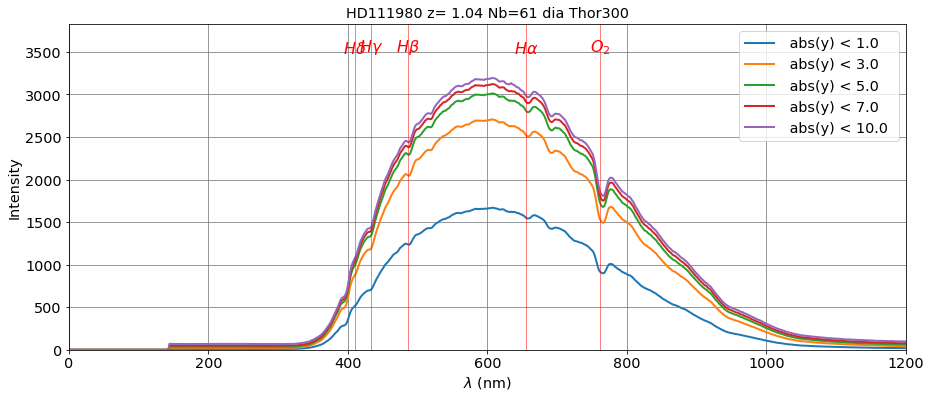

In [47]:
sel=3
ShowLongitudinalSpectraSelection(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_holoamag.pdf')

## Quality of O2

In [48]:
def ShowOneAbsorptionLine(index,all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):
    """
    """
    
    O2WL1=740
    O2WL2=750
    O2WL3=780
    O2WL4=790
    
    wl1=O2WL1
    wl2=O2WL2
    wl3=O2WL3
    wl4=O2WL4
    
    plt.figure(figsize=(10,6))
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    wsel_set=np.array([1.,3.,5.,7.,10.])
    NBSEL=wsel_set.shape[0]
    
    #x0=int(x_pointing[index])
    x0=int(all_pointing[index][0])
    
    figfilename=os.path.join(dir_top_img,figname)   
        
      
    thetitle=all_titles[index]+' '+all_filt[index]   
    
    
    full_image=np.copy(all_images[index])
    yprofile=np.sum(full_image[:,spec_index_min:spec_index_max],axis=1)
    y0=np.where(yprofile==yprofile.max())[0][0]

    reduc_image=full_image[y0-20:y0+20,x0:spec_index_max]/all_expo[index] 
    reduc_image[:,0:100]=0  # erase central star
    
    X_Size_Pixels=np.arange(0,reduc_image.shape[1])
    Y_Size_Pixels=np.arange(0,reduc_image.shape[0])
    Transverse_Pixel_Size=Y_Size_Pixels-int(float(Y_Size_Pixels.shape[0])/2.)
    
    
    grating_name=all_filt[sel].replace('dia ','')
    holo = Hologram(grating_name,verbose=True)
    lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
    
    
    
        # 1 container of full 1D Spectra
    all_longitudinal_profile = []
    for thewsel in wsel_set:                
        y_indexsel=np.where(np.abs(Transverse_Pixel_Size)<=thewsel)[0]      
        longitudinal_profile2d=np.copy(reduc_image[y_indexsel,:])
        longitudinal_profile1d=np.sum(longitudinal_profile2d,axis=0)
        all_longitudinal_profile.append(longitudinal_profile1d)
    # 2 bins of the region around abs line    
    selected_indexes=np.where(np.logical_and(lambdas>=wl1,lambdas<=wl4))        
    wl_cut=lambdas[selected_indexes]
    
    # 3 continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(lambdas>=wl1,lambdas<=wl2),np.logical_and(lambdas>=wl3,lambdas<wl4)))
    wl_cont=lambdas[continuum_indexes]
    
    
    # 3 extract sub-spectrum
    all_absline_profile = []
    all_cont_profile = []
    fit_line_x=np.linspace(wl1,wl4,50)
    idx=0
    for thewsel in wsel_set: 
        full_spec=all_longitudinal_profile[idx]
        spec_cut=full_spec[selected_indexes]
        all_absline_profile.append(spec_cut)
        
        spec_cont=full_spec[continuum_indexes]
        z_cont_fit=np.polyfit(wl_cont, spec_cont,1)
        pol_cont_fit=np.poly1d(z_cont_fit)        
        fit_line_y=pol_cont_fit(fit_line_x)
        all_cont_profile.append(fit_line_y)        
        idx+=1
    # 4 plot
    idx=0
    for thewsel in wsel_set: 
        thelabel='abs(y) < {} '.format(thewsel)
        plt.plot(wl_cut,all_absline_profile[idx],'-',label=thelabel,lw=2)
        plt.plot(fit_line_x,all_cont_profile[idx],'k:')
        idx+=1
    
    
    
    plt.title(thetitle)
   
    
    plt.grid(color='grey', ls='solid')
    #plt.text(100,-5.,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
    plt.xlabel('$\lambda$ (nm)')
    plt.ylabel('Intensity')
    
    plt.xlim(wl1,wl4+20)
    #plt.ylim(0.,YMAX)
    plt.legend(loc=1)
    plt.savefig(figfilename)




Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


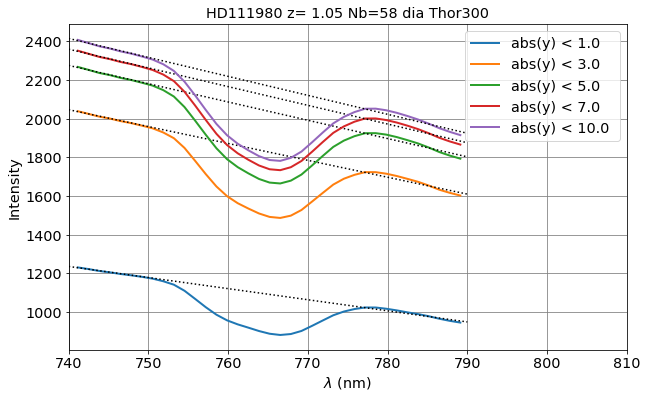

In [49]:
sel=0
ShowOneAbsorptionLine(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_o2absline_thor300.pdf')

Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


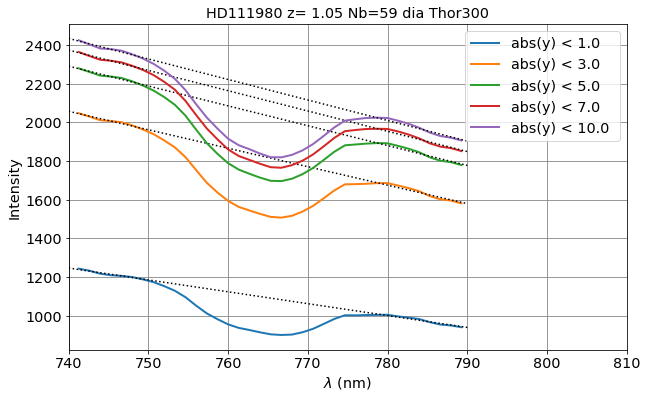

In [50]:
sel=1
ShowOneAbsorptionLine(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_o2absline_holophp.pdf')

Load hologram Ron400:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.3 degrees
Hologram center at x0 = 741.0 and y0 = 741.0 with average tilt of -0.3 degrees
Order  0 position at x0 = 435.0 and y0 = 742.5
Order +1 position at x0 = 1047.0 and y0 = 739.5
Distance between the orders: 611.97 pixels (14.69 mm)


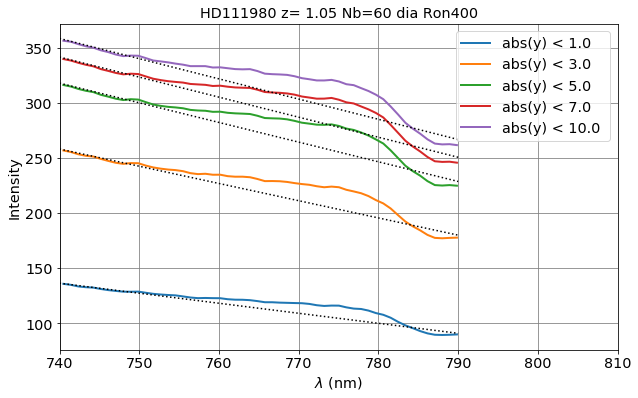

In [51]:
sel=2
ShowOneAbsorptionLine(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_o2absline_holophag.pdf')

Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


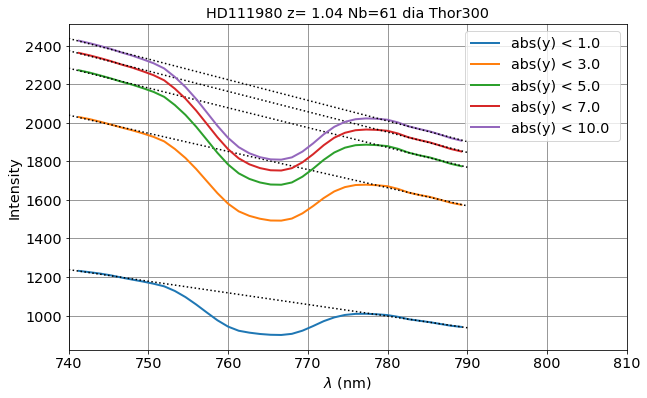

In [52]:
sel=3
ShowOneAbsorptionLine(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_o2absline_holoamag.pdf')

In [53]:
def ShowOneEquivWidth(index,all_images,all_pointing,all_titles,object_name,all_expo,dir_top_img,all_filt,figname):
    """
    """
    
    O2WL1=740
    O2WL2=750
    O2WL3=780
    O2WL4=790
    
    wl1=O2WL1
    wl2=O2WL2
    wl3=O2WL3
    wl4=O2WL4
    
    plt.figure(figsize=(10,6))
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    wsel_set=np.array([1.,3.,5.,7.,10.])
    NBSEL=wsel_set.shape[0]
    
    #x0=int(x_pointing[index])
    x0=int(all_pointing[index][0])
    
    figfilename=os.path.join(dir_top_img,figname)   
        
      
    thetitle=all_titles[index]+' '+all_filt[index]   
    
    
    full_image=np.copy(all_images[index])
    yprofile=np.sum(full_image[:,spec_index_min:spec_index_max],axis=1)
    y0=np.where(yprofile==yprofile.max())[0][0]

    reduc_image=full_image[y0-20:y0+20,x0:spec_index_max]/all_expo[index] 
    reduc_image[:,0:100]=0  # erase central star
    
    X_Size_Pixels=np.arange(0,reduc_image.shape[1])
    Y_Size_Pixels=np.arange(0,reduc_image.shape[0])
    Transverse_Pixel_Size=Y_Size_Pixels-int(float(Y_Size_Pixels.shape[0])/2.)
    
    
    grating_name=all_filt[sel].replace('dia ','')
    holo = Hologram(grating_name,verbose=True)
    lambdas=holo.grating_pixel_to_lambda(X_Size_Pixels,all_pointing[index])
    
    # 1 container of full 1D Spectra
    all_longitudinal_profile = []
    for thewsel in wsel_set:                
        y_indexsel=np.where(np.abs(Transverse_Pixel_Size)<=thewsel)[0]      
        longitudinal_profile2d=np.copy(reduc_image[y_indexsel,:])
        longitudinal_profile1d=np.sum(longitudinal_profile2d,axis=0)
        all_longitudinal_profile.append(longitudinal_profile1d)
    # 2 bins of the region around abs line    
    selected_indexes=np.where(np.logical_and(lambdas>=wl1,lambdas<=wl4))        
    wl_cut=lambdas[selected_indexes]
    
    # 3 continuum fit
    continuum_indexes=np.where(np.logical_or(np.logical_and(lambdas>=wl1,lambdas<=wl2),np.logical_and(lambdas>=wl3,lambdas<wl4)))
    wl_cont=lambdas[continuum_indexes]
    
    
    # 3 extract sub-spectrum
    all_absline_profile = []
    all_cont_profile = []
    all_ratio = []
    fit_line_x=np.linspace(wl1,wl4,50)
    idx=0
    for thewsel in wsel_set: 
        full_spec=all_longitudinal_profile[idx]
        spec_cut=full_spec[selected_indexes]
        all_absline_profile.append(spec_cut)
        
        spec_cont=full_spec[continuum_indexes]
        z_cont_fit=np.polyfit(wl_cont, spec_cont,1)
        pol_cont_fit=np.poly1d(z_cont_fit)        
        fit_line_y=pol_cont_fit(fit_line_x)
        full_continum=pol_cont_fit(wl_cut) 
        ratio=spec_cut/full_continum
        all_cont_profile.append(fit_line_y)
        all_ratio.append(ratio)        
        idx+=1
    # 4 plot
    idx=0
    for thewsel in wsel_set:
        thelabel='abs(y) < {} '.format(thewsel)
        plt.plot(wl_cut,all_ratio[idx],'-',label=thelabel,lw=2)
        idx+=1

    
    plt.title(thetitle)
   
    
    plt.grid(color='grey', ls='solid')
    #plt.text(100,-5.,all_filt[index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)
    plt.xlabel('$\lambda$ (nm)')
    plt.ylabel('Equivalent Width')
    
    plt.xlim(wl1,wl4+20)
    #plt.ylim(0.,YMAX)
    plt.legend(loc=1)
    plt.savefig(figfilename)





Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


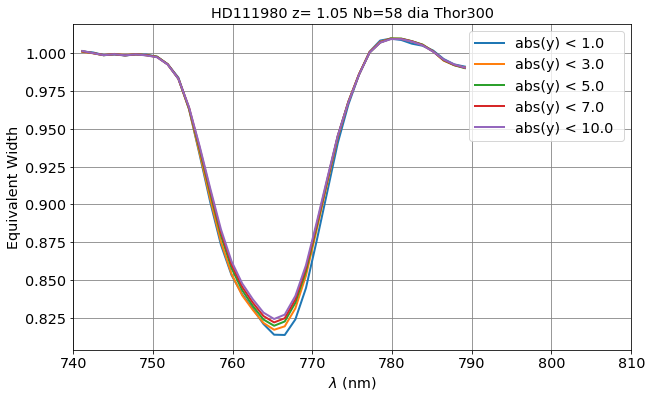

In [54]:
sel=0
ShowOneEquivWidth(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_eqwwidth_thor300.pdf')

Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


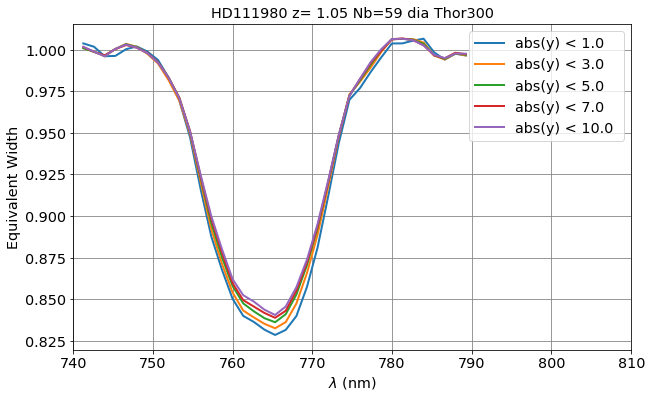

In [55]:
sel=1
ShowOneEquivWidth(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_eqwwidth_holophp.pdf')

Load hologram Ron400:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.3 degrees
Hologram center at x0 = 741.0 and y0 = 741.0 with average tilt of -0.3 degrees
Order  0 position at x0 = 435.0 and y0 = 742.5
Order +1 position at x0 = 1047.0 and y0 = 739.5
Distance between the orders: 611.97 pixels (14.69 mm)


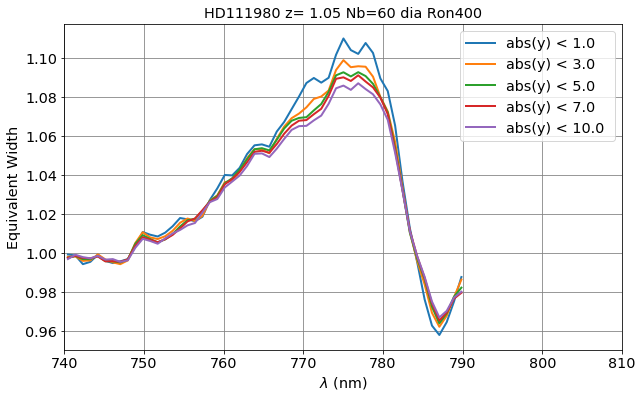

In [56]:
sel=2
ShowOneEquivWidth(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_eqwwidth_holophag.pdf')

Load hologram Thor300:
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Order  0 position at x0 = 1172.7 and y0 = 1266.3
Order +1 position at x0 = 1623.3 and y0 = 1261.7
Distance between the orders: 450.55 pixels (10.81 mm)


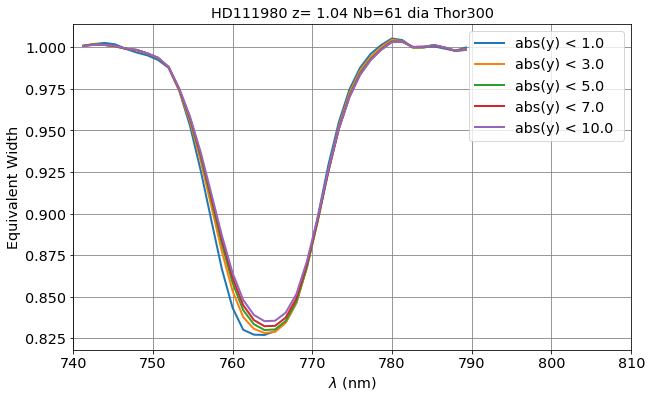

In [57]:
sel=3
ShowOneEquivWidth(sel,all_images,order0_positions,all_titles,object_name,all_expo,dir_top_images,all_filt,'long_eqwwidth_holoamag.pdf')

# Extraction of spectra

In [58]:
import numpy as np
import matplotlib.pyplot as plt
import os

import math as m

from matplotlib.backends.backend_pdf import PdfPages 


def ShowTransverseProfile(all_images,thex0,all_titles,object_name,all_expo,dir_top_img,NBIMGPERROW=2):
    """
    ShowTransverseProfile: Show the raw images without background subtraction
    =====================
    The goal is to see in y, where is the spectrum maximum. Returns they0
    
    """
    NBIMGPERROW=2
    NBIMAGES=len(all_images)
    MAXIMGROW=max(2,m.ceil(NBIMAGES/NBIMGPERROW))
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70  
    
    
    title='Spectrum tranverse profile '.format(object_name)
    
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    
    figfilename=os.path.join(dir_top_img,'transverse_profile.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    
    

    ############       Criteria for spectrum region selection #####################
    DeltaX=1000
    w=10
    ws=80
    Dist=4*w
    right_edge = 1800
    ##############################################################################
    
    # containers
    thespectra= []
    thespectraUp=[]
    thespectraDown=[]
    
    they0 = []  # container for the y value
    
    # loop on images
    #-----------------
    for index in np.arange(0,NBIMAGES):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        
        data=np.copy(all_images[index])[:,0:right_edge]
        
        x0=int(thex0[index])

        # Do not erase central star please
        #data[:,x0-100:x0+100]=0 ## TURN OFF CENTRAL STAR
        
        if(all_expo[index]<=0):            
            yprofile=np.sum(data,axis=1)
        else:
            yprofile=np.sum(data,axis=1)/all_expo[index]
            
            
        ymin=1
        ymax=yprofile.max()
        y0=np.where(yprofile==ymax)[0][0]
        they0.append(y0)
        
        
        
        #y0 = they0[index]
        #im=axarr[iy,ix].imshow(data,vmin=-10,vmax=50)
        axarr[iy,ix].semilogy(yprofile)
        axarr[iy,ix].semilogy([y0,y0],[ymin,ymax],'r-')
        axarr[iy,ix].semilogy([y0-w,y0-w],[ymin,ymax],'k-')
        axarr[iy,ix].semilogy([y0+w,y0+w],[ymin,ymax],'k-')
        
        ##########################################################
        #### Here extract the spectrum around the central star
        #####   Take the sum un bins along y
        #############################################################
        
        spectrum2D=np.copy(data[y0-w:y0+w,:])
        xprofile=np.sum(spectrum2D,axis=0)

        
        ### Lateral bands to remove sky background
        ### ---------------------------------------
        spectrum2DUp=np.copy(data[y0-w+Dist:y0+w+Dist,:])
        xprofileUp=np.median(spectrum2DUp,axis=0)*2.*float(w)

        spectrum2DDown=np.copy(data[y0-w-Dist:y0+w-Dist,:])
        xprofileDown=np.median(spectrum2DDown,axis=0)*2.*float(w)
        
        
        if(all_expo[index]<=0):
            thespectra.append(xprofile)
            thespectraUp.append(xprofileUp)
            thespectraDown.append(xprofileDown)
        else:  ################## HERE I NORMALISE WITH EXPO TIME ####################################
            thespectra.append(xprofile/all_expo[index])
            thespectraUp.append(xprofileUp/all_expo[index]) 
            thespectraDown.append(xprofileDown/all_expo[index]) 

        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
    
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
          
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()
  
    
    return thespectra,thespectraUp,thespectraDown,they0

/Users/dagoret/anaconda/lib/python2.7/site-packages/numpy/core/fromnumeric.py:2889: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/dagoret/anaconda/lib/python2.7/site-packages/numpy/core/_methods.py:73: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


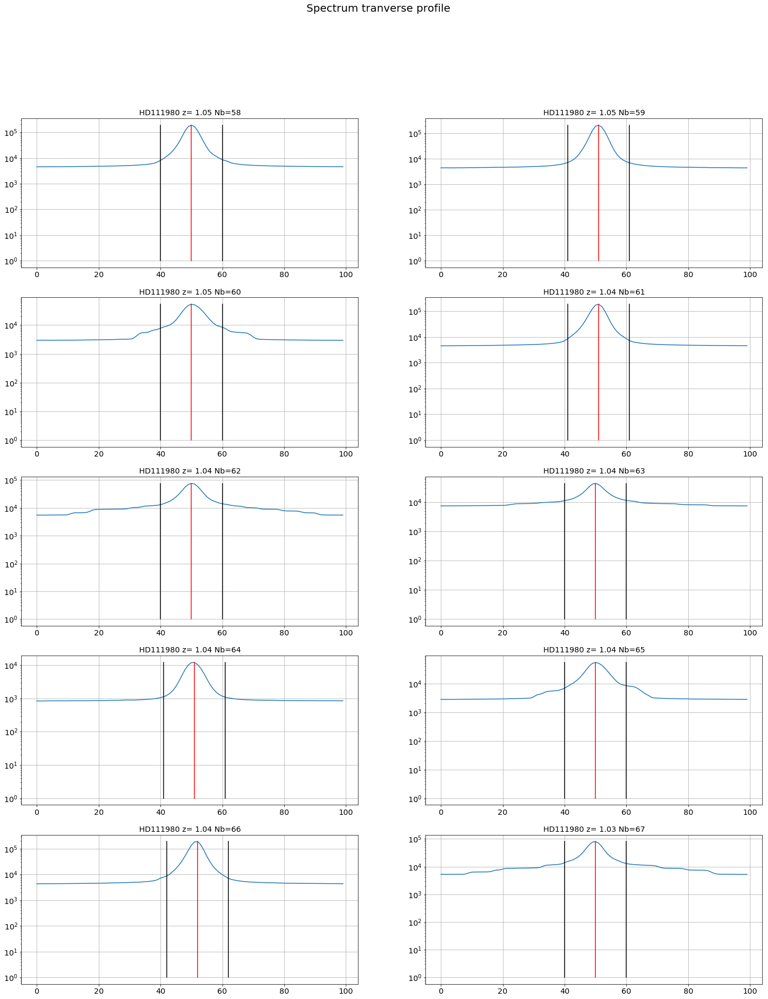

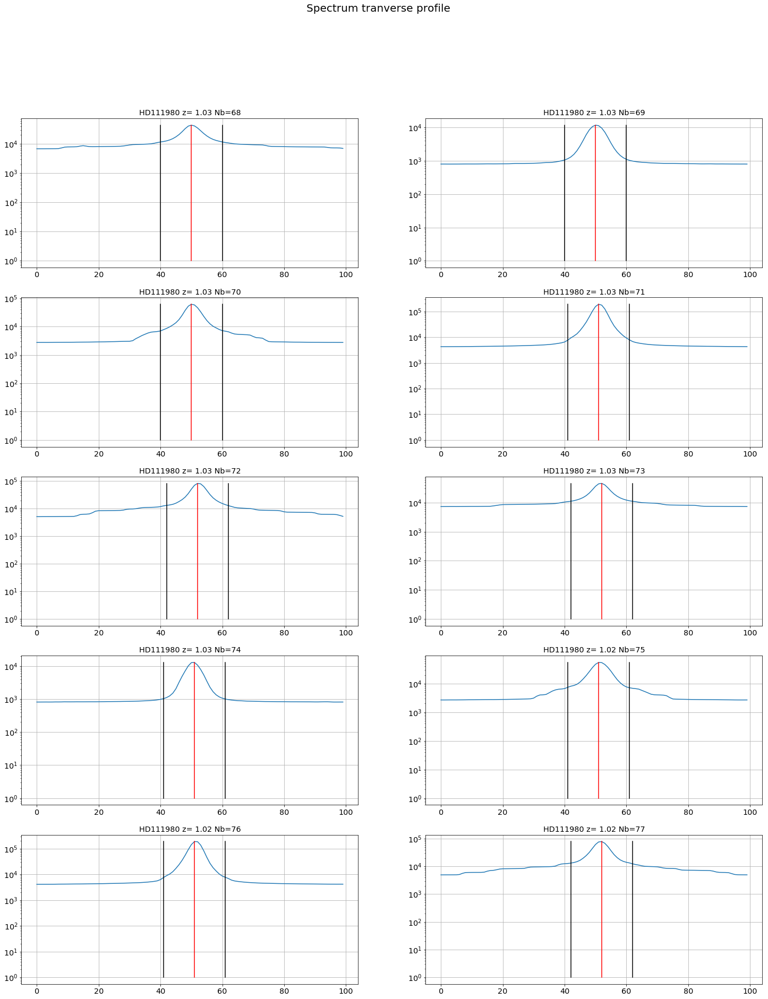

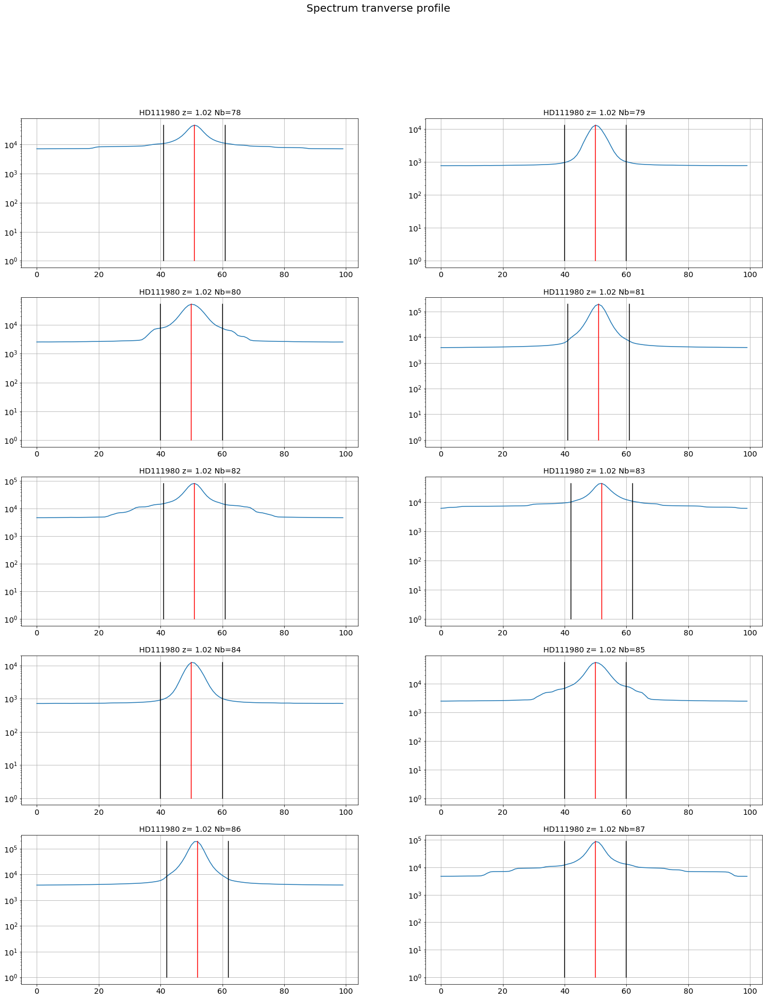

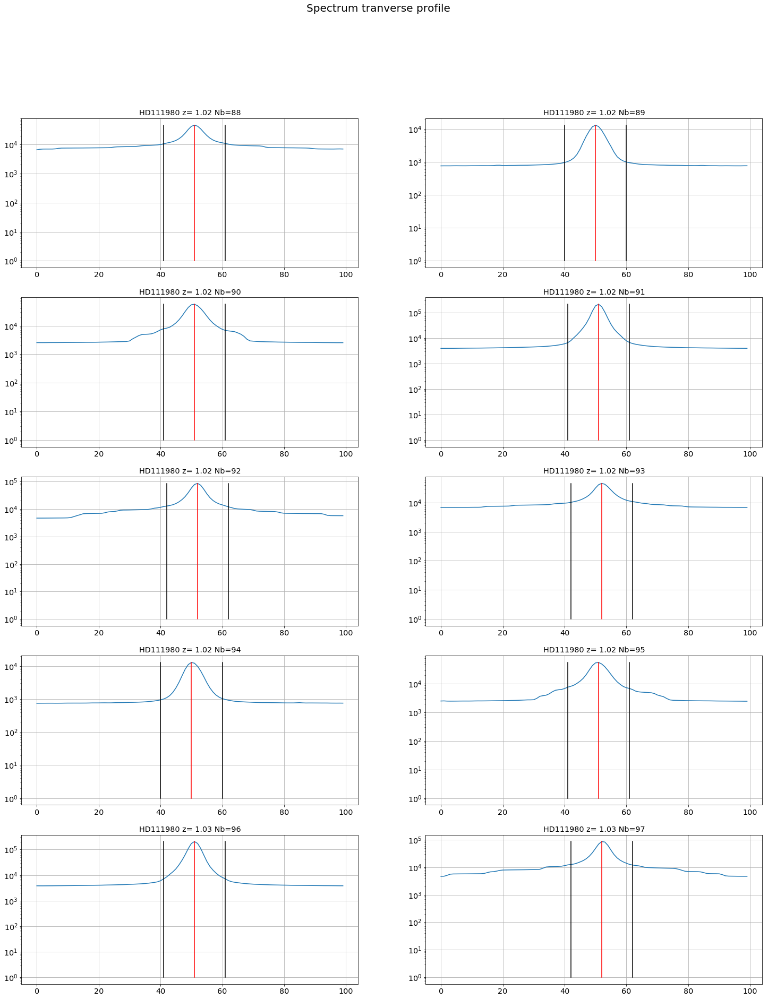

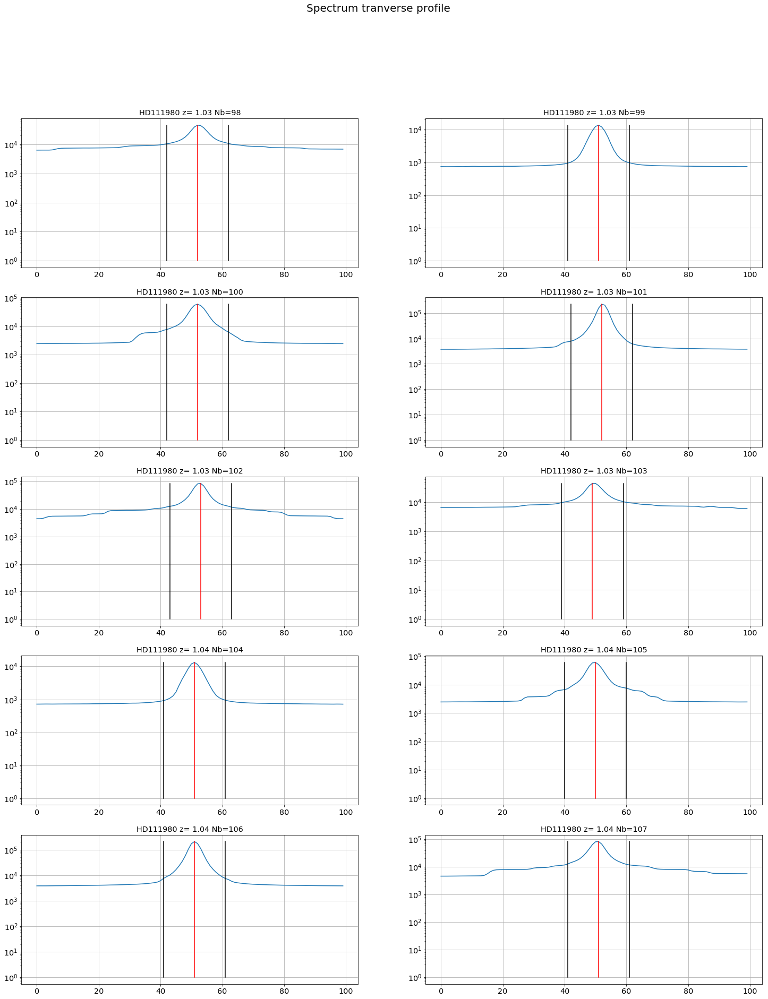

...

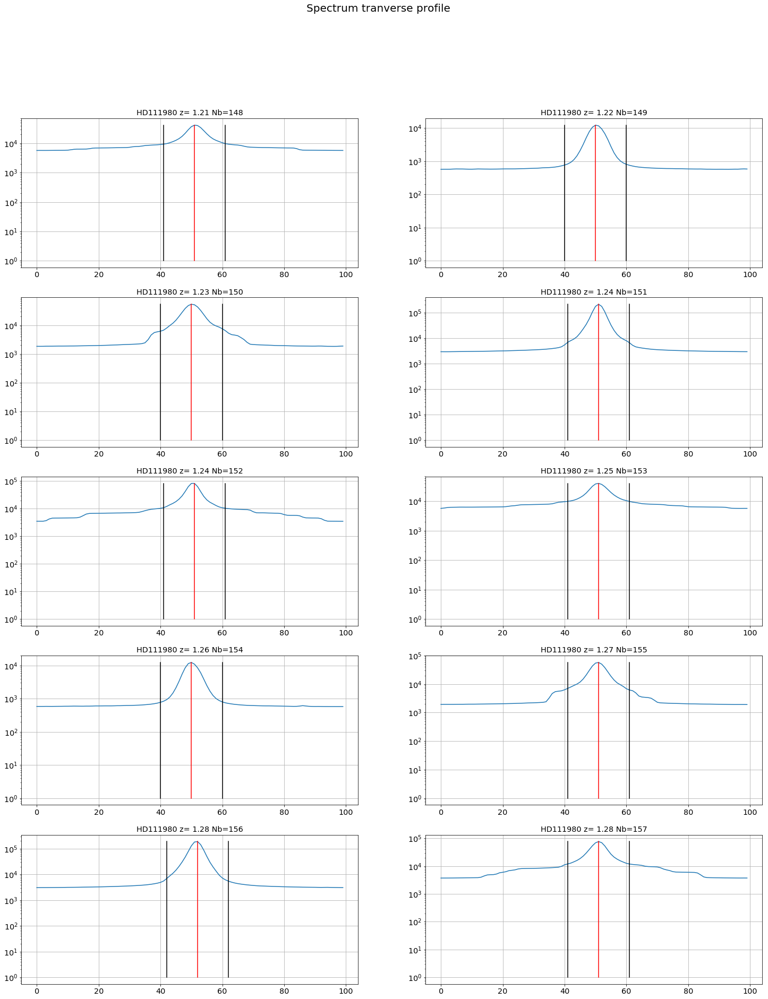

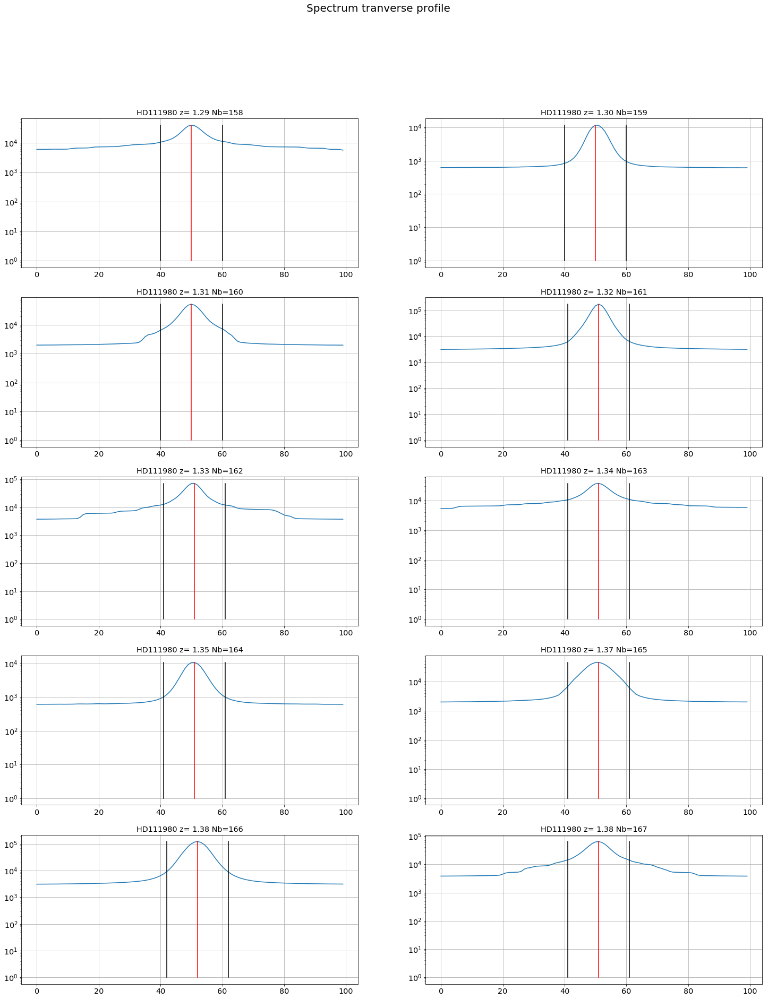

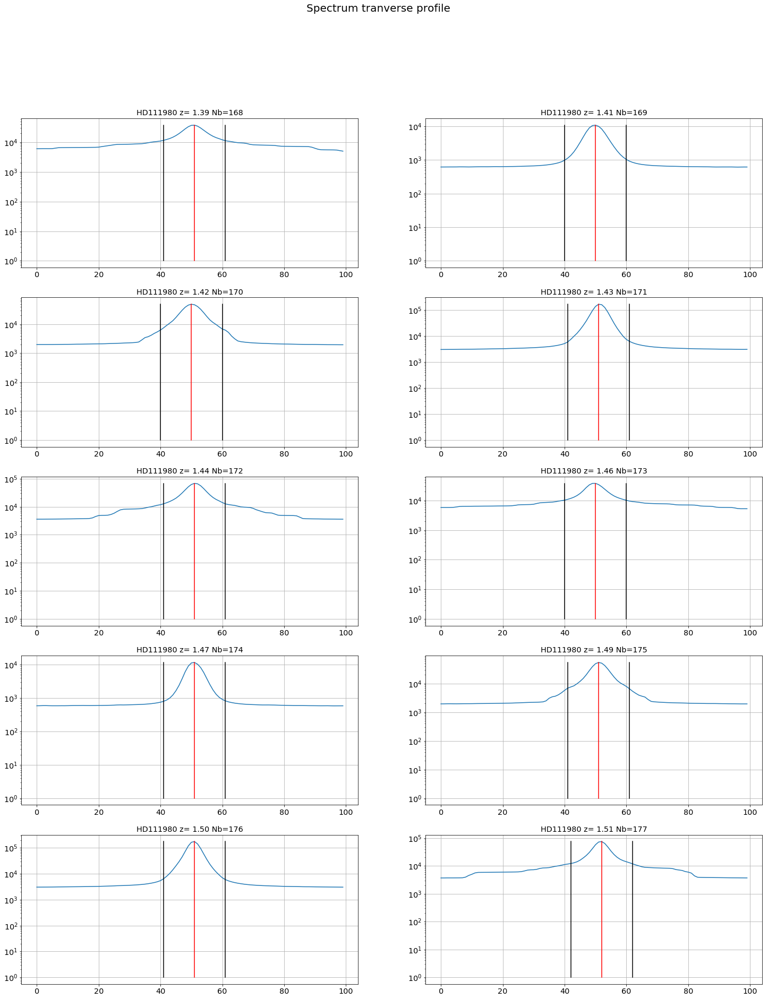

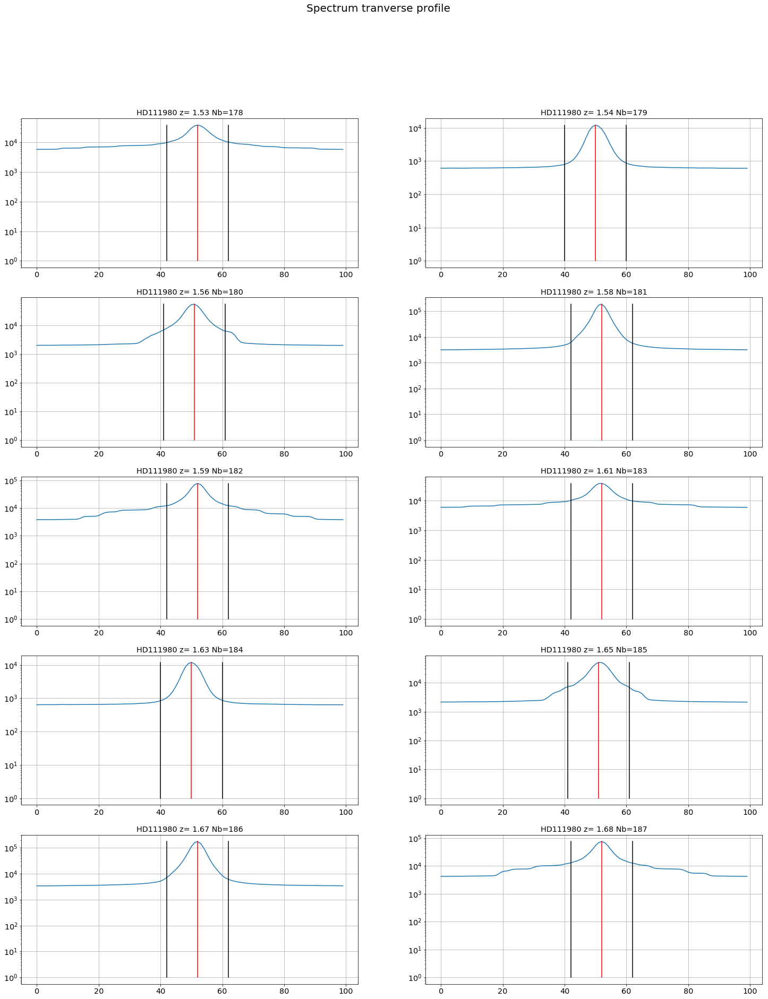

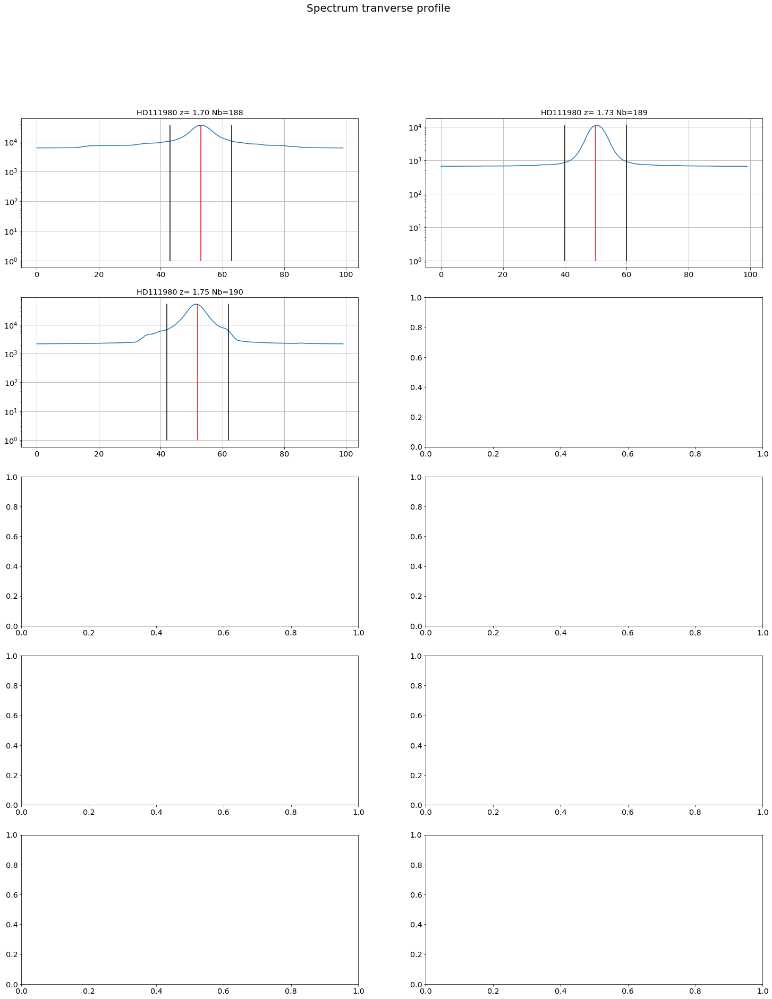

In [59]:
thespectra,thespectraUp,thespectraDown,they0=ShowTransverseProfile(all_images,x_pointing,all_titles,object_name,all_expo,dir_top_images)

# Extraction of the spectrum from the 2D - Images


### Check the transverse spectrum does not show multi-bum

This proves the rotation may be OK

## Extract the longitudinal spectrum with its lateral bands

In [60]:
thespectra,thespectraUp,thespectraDown=ExtractSpectra(y_star,all_images,all_titles,object_name,all_expo,
                                                      w=10,ws=[50,60],right_edge=1800)

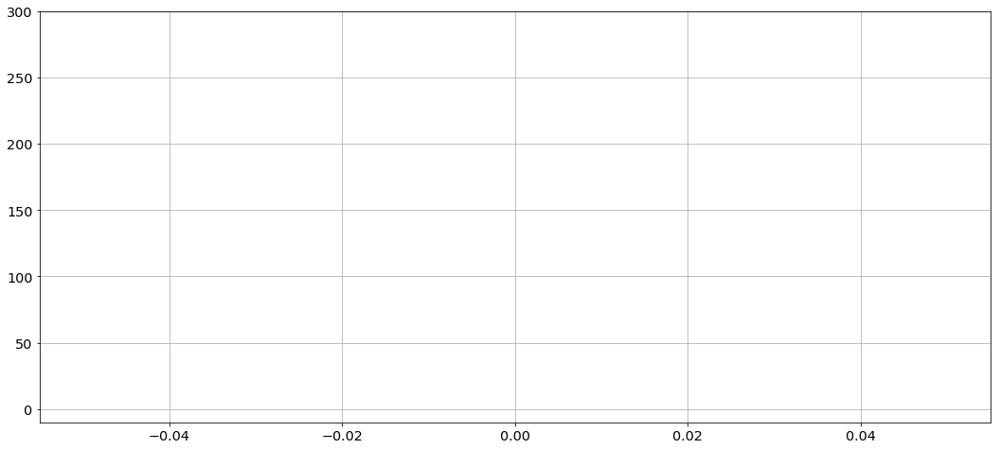

In [61]:
sel=1

plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(thespectraUp[sel],'b-') 
plt.plot(thespectraDown[sel],'g-')
#plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(-10.,300.)
figfilename=os.path.join(dir_top_images,'bckg_sample.pdf')
plt.savefig(figfilename) 

In [62]:
thespectraAv=np.array(thespectraUp+thespectraDown)/2.

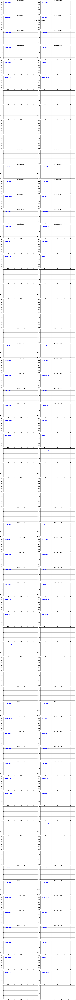

In [63]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)

In [64]:
import math as m
from matplotlib.backends.backend_pdf import PdfPages
def ShowFullLongitBackground(spectra,spectraUp,spectraDown,spectraAv,all_titles,object_name,NBIMGPERROW,dir_top_images):
    """
    Show the background to be removed to the spectrum
    
    Implemented to write in a pdf file
    
    """
    NBSPEC=len(spectra)
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Longitudinal background Up/Down'.format(object_name)
    
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    for index in np.arange(0,NBSPEC):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        # plot what is wanted
        axarr[iy,ix].plot(spectra[index],'r-')
        axarr[iy,ix].plot(spectraUp[index],'b-')
        axarr[iy,ix].plot(spectraDown[index],'g-')
        axarr[iy,ix].plot(spectraAv[index],'m-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        
        star_pos=np.where(spectra[index][:spec_index_max]==spectra[index][:spec_index_max].max())[0][0]
        max_y_to_plot=(spectra[index][star_pos+star_halfwidth:spec_index_max]).max()*1.2
        
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].text(spec_index_min,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='center',color='blue',fontweight='bold', fontsize=20)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
        
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()

IndexError: index 0 is out of bounds for axis 0 with size 0

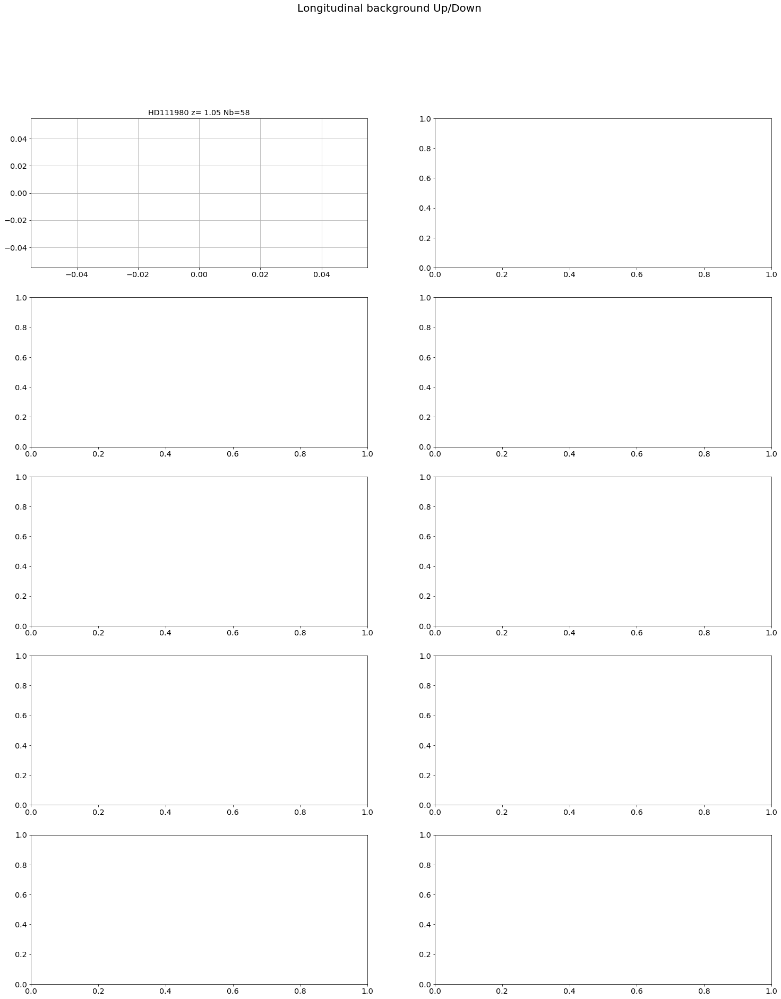

In [65]:
ShowFullLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,object_name,2,dir_top_images)

## If OK then cleaning

In [ ]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

In [ ]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)
figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
plt.savefig(figfilename)   

In [ ]:
sel=1
plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(Clean_Up[sel],'b-') 
plt.plot(Clean_Do[sel],'g-')
plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,500.)